# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = ((gradient_norm-1)**2).mean()
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -crit_fake_pred.mean()
    #### END CODE HERE ####
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [26]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = crit_fake_pred.mean()-crit_real_pred.mean()+gp*c_lambda
    #### END CODE HERE ####
    return crit_loss

In [27]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08836030738893896, critic loss: 1.8812190881818531


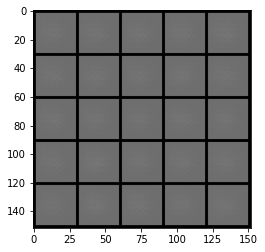

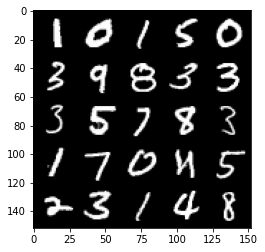

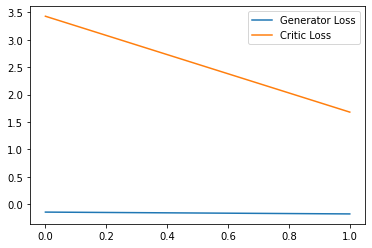

Step 100: Generator loss: 1.103247825652361, critic loss: -2.090953861504793


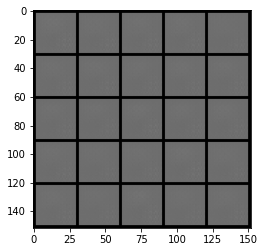

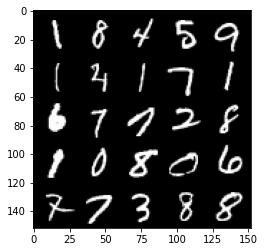

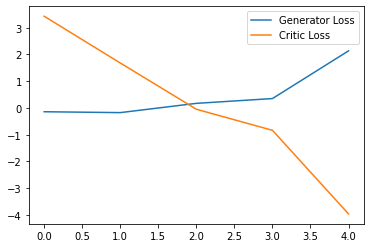

Step 150: Generator loss: 2.3209875339642165, critic loss: -10.826131891250606


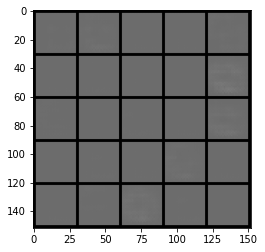

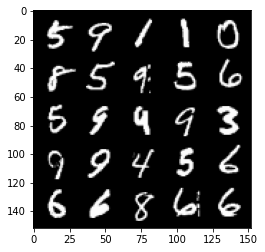

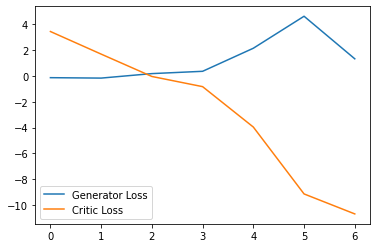

Step 200: Generator loss: -0.6871180178970099, critic loss: -27.362126903533934


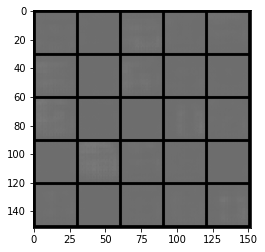

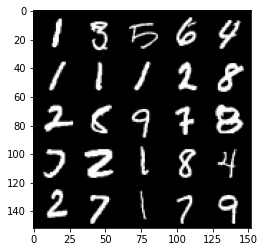

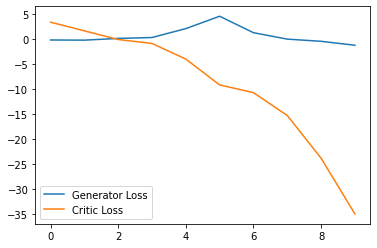

Step 250: Generator loss: -1.9478145521879195, critic loss: -58.627849639892595


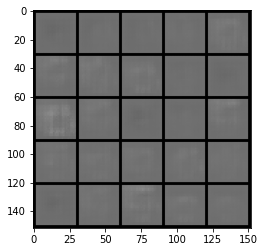

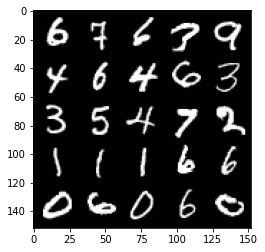

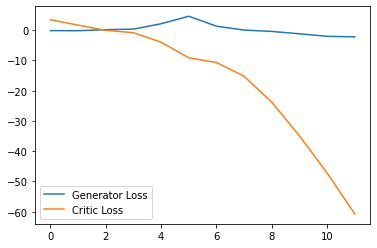

Step 300: Generator loss: 0.3601824617385864, critic loss: -98.3613567352295


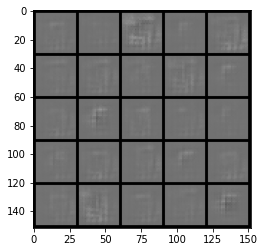

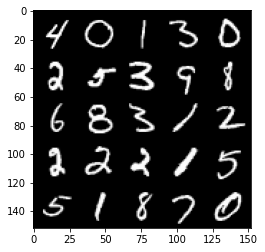

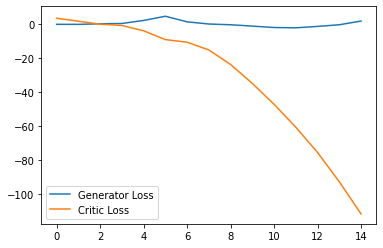

Step 350: Generator loss: 4.213262152671814, critic loss: -148.99240335083005


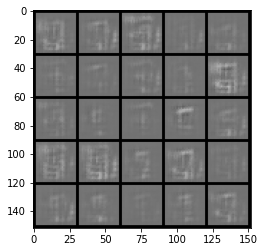

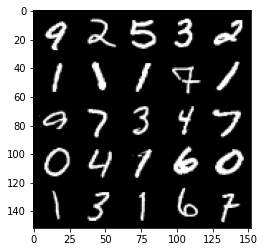

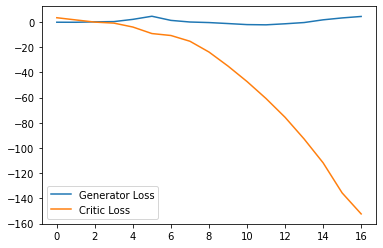

Step 400: Generator loss: 7.7852994513511655, critic loss: -195.10970431518558


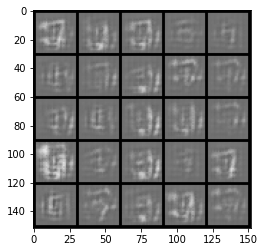

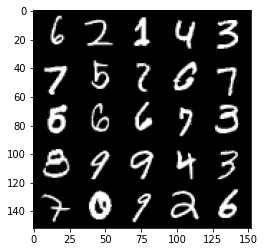

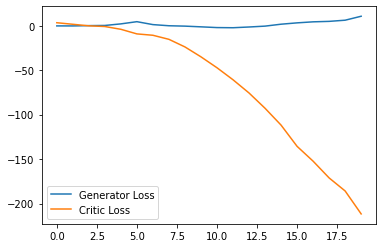

Step 450: Generator loss: -14.939190509319305, critic loss: -168.2720588684082


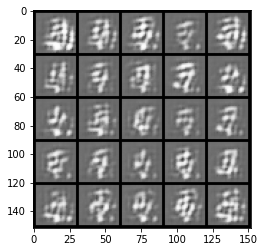

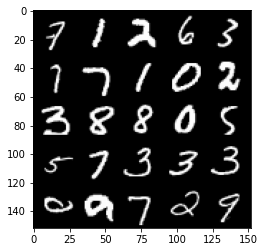

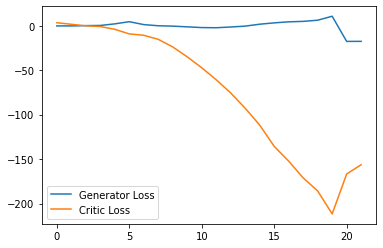

Step 500: Generator loss: -1.4726037257909774, critic loss: -211.81298672485352


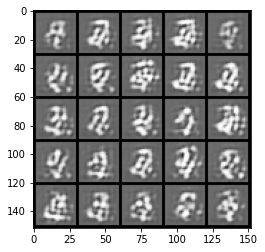

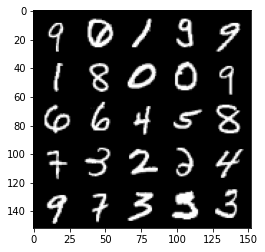

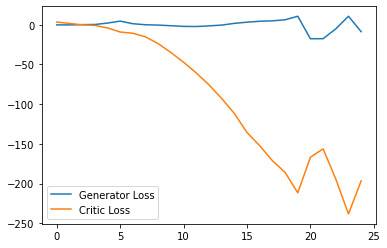

Step 550: Generator loss: 15.99799940109253, critic loss: -245.21821597290048


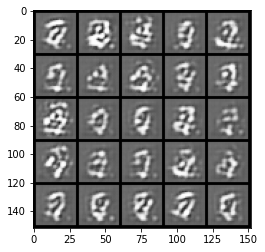

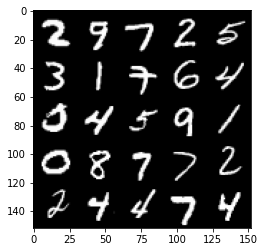

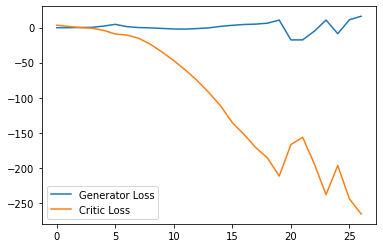

Step 600: Generator loss: -2.4533895602822304, critic loss: -213.58720138549802


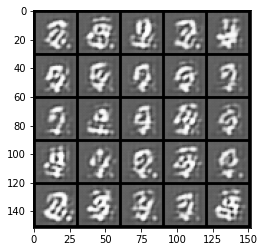

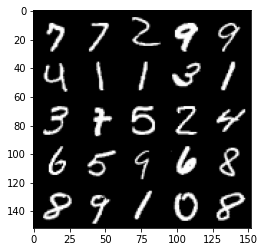

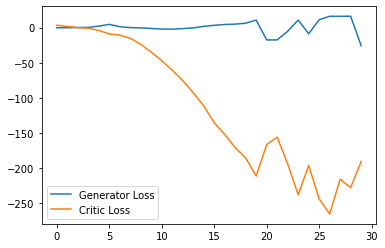

Step 650: Generator loss: -10.097899882793426, critic loss: -199.16078817749025


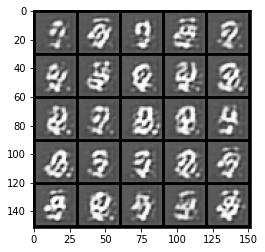

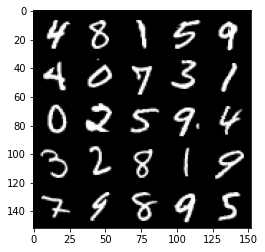

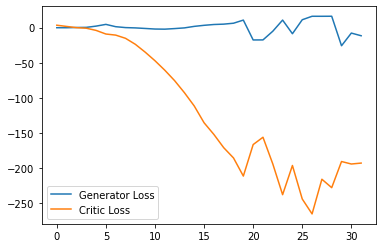

Step 700: Generator loss: -12.222181423902512, critic loss: -204.95123751831056


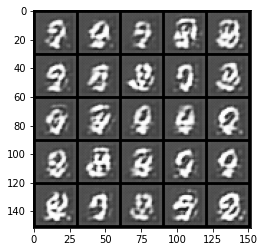

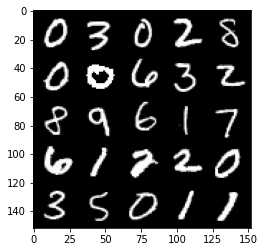

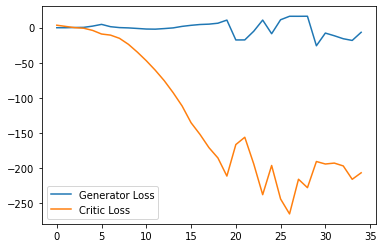

Step 750: Generator loss: -13.341646342277526, critic loss: -199.8987428894043


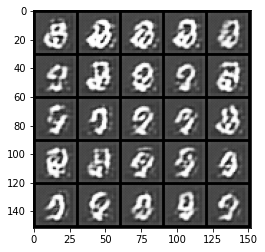

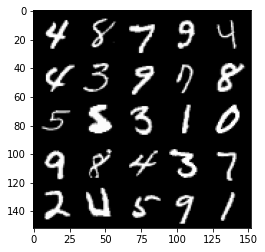

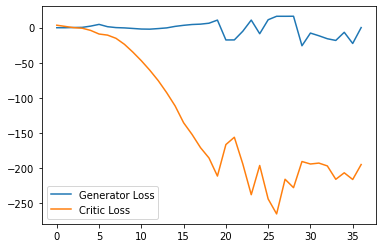

Step 800: Generator loss: -20.74014920413494, critic loss: -140.46708003616334


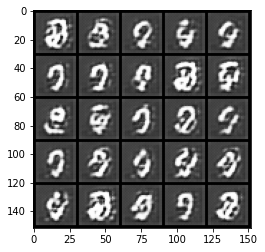

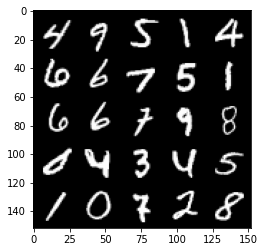

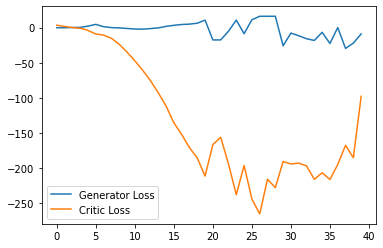

Step 850: Generator loss: -41.443552069664, critic loss: -102.87409565734862


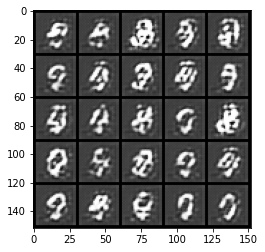

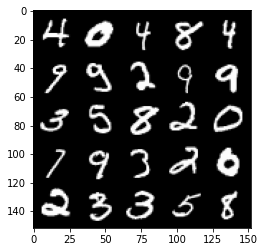

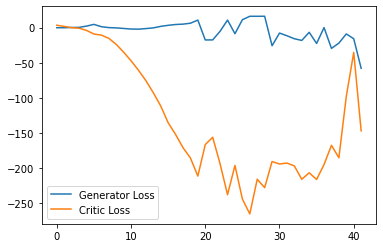

Step 900: Generator loss: -36.87785480499267, critic loss: -100.40249343109127


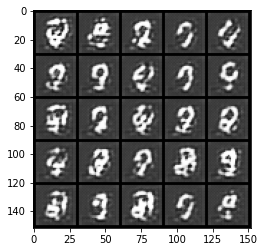

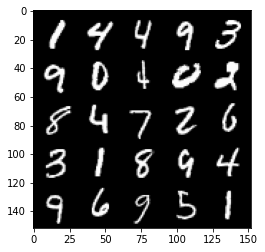

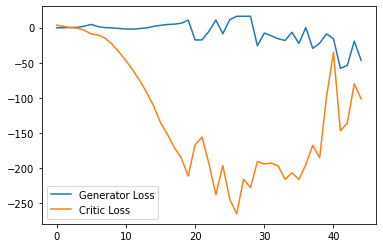

Step 950: Generator loss: -22.76774514198303, critic loss: -104.39055767440797


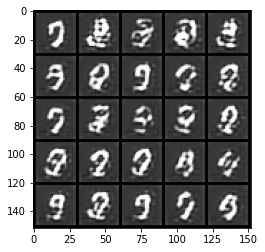

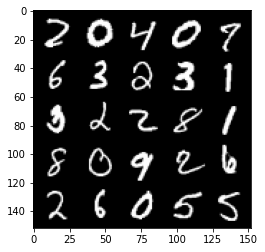

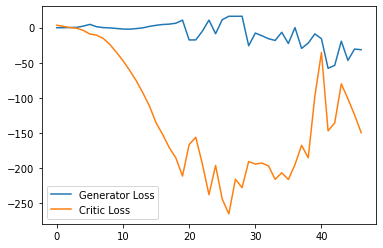

Step 1000: Generator loss: 7.6544295501708985, critic loss: 8.0880389919281


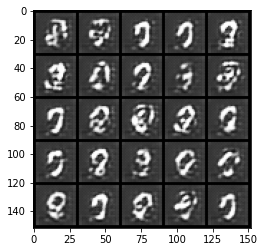

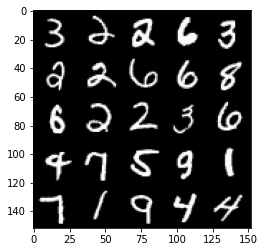

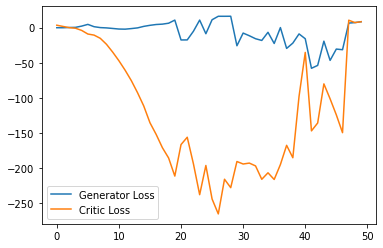

Step 1050: Generator loss: 8.955066194534302, critic loss: 1.2910260200500485


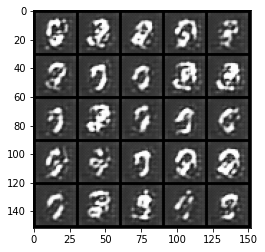

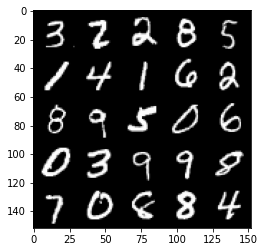

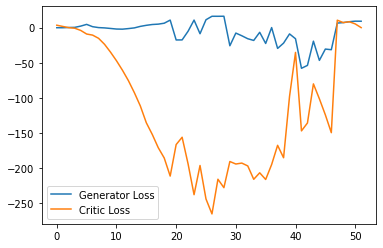

Step 1100: Generator loss: 5.463805142641068, critic loss: -6.375500164031983


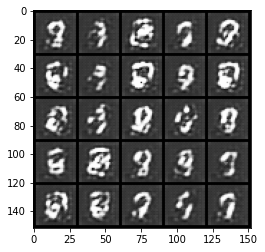

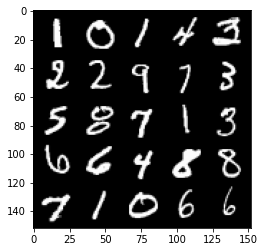

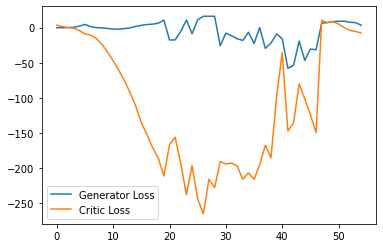

Step 1150: Generator loss: -13.518840221166611, critic loss: -52.29086076354981


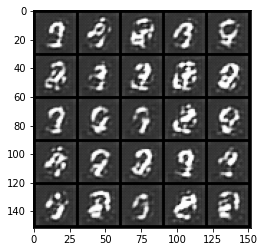

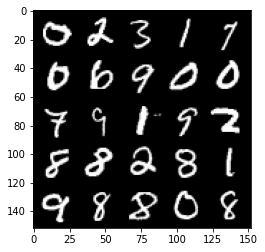

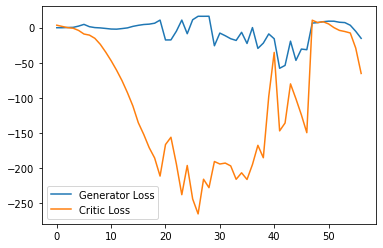

Step 1200: Generator loss: -26.11419885635376, critic loss: -86.15826551055905


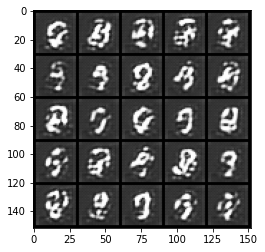

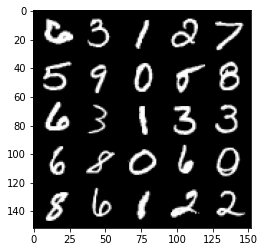

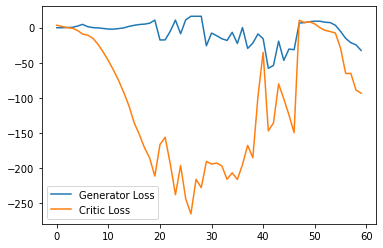

Step 1250: Generator loss: -8.836246231794357, critic loss: -36.00224699020386


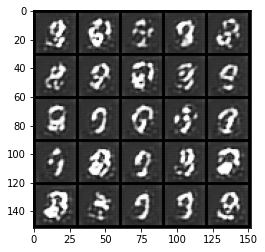

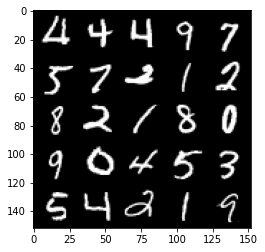

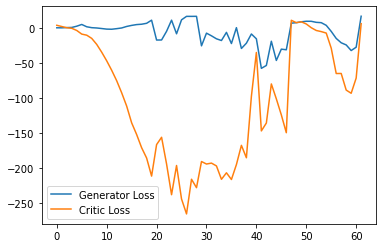

Step 1300: Generator loss: -28.820494050979615, critic loss: -45.36634085083006


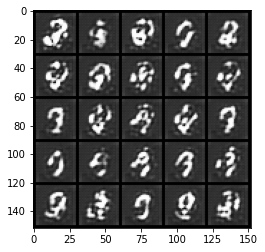

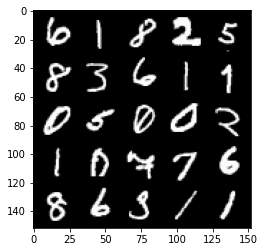

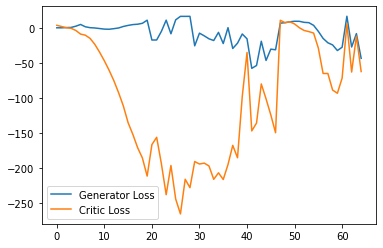

Step 1350: Generator loss: -47.95746515035629, critic loss: -81.01621141815185


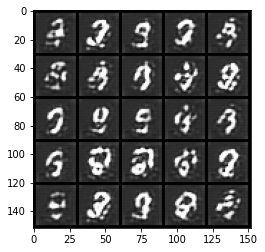

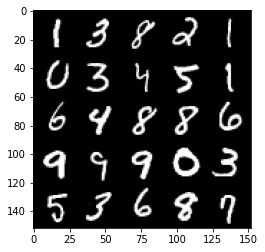

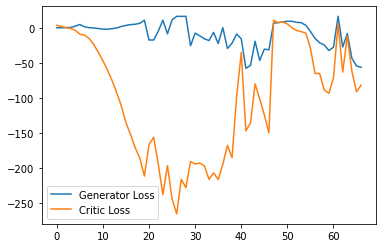

Step 1400: Generator loss: -28.879676456451417, critic loss: -41.639846443176246


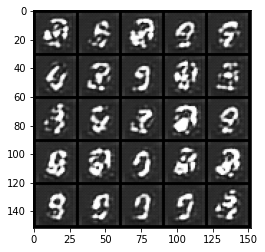

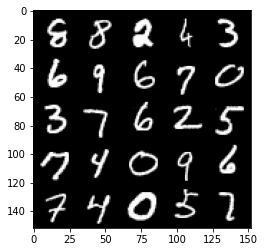

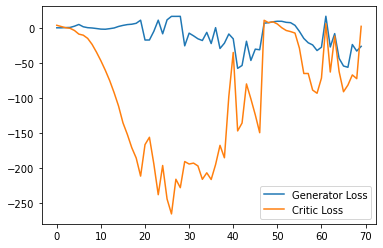

Step 1450: Generator loss: -0.9539899039268493, critic loss: 6.901348452568053


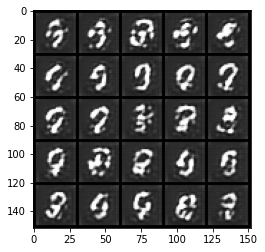

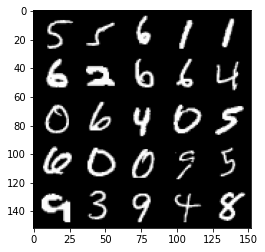

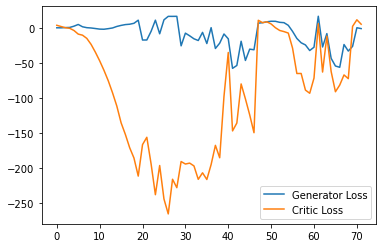

Step 1500: Generator loss: -1.459970189332962, critic loss: 3.1293740224838262


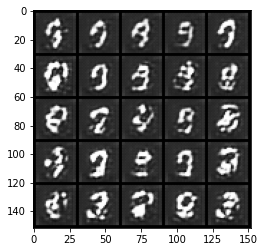

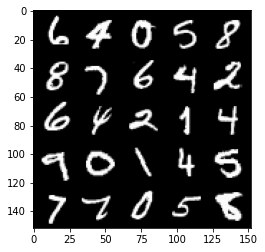

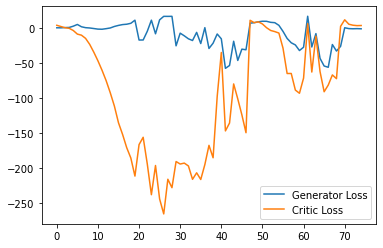

Step 1550: Generator loss: -1.6278949880599975, critic loss: 4.513045919418334


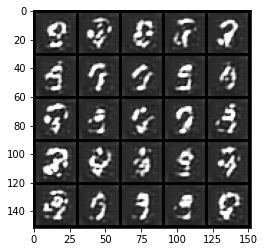

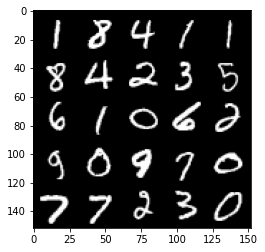

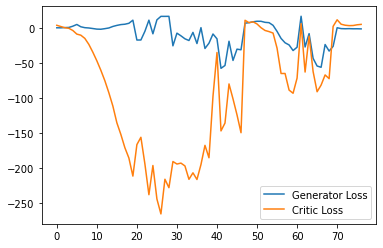

Step 1600: Generator loss: -2.258071608543396, critic loss: 3.6835279760360713


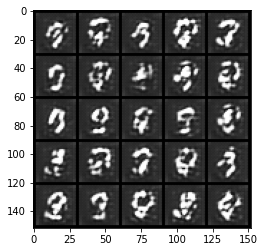

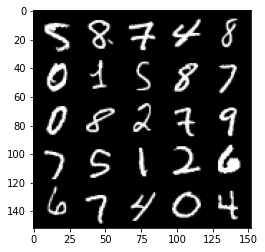

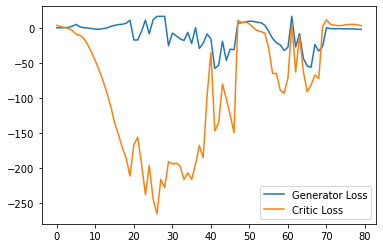

Step 1650: Generator loss: -2.8790370512008665, critic loss: 1.0519881916046145


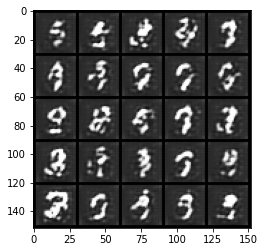

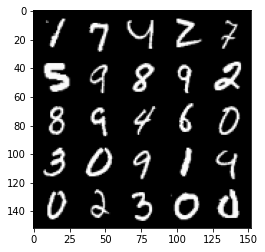

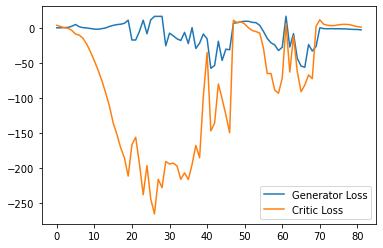

Step 1700: Generator loss: -3.2039317226409914, critic loss: 0.496154044151306


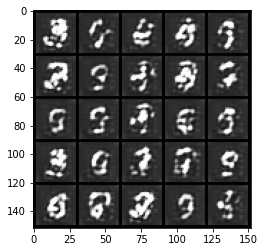

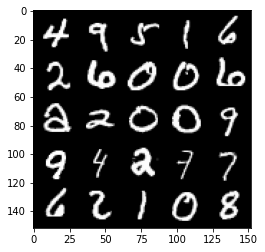

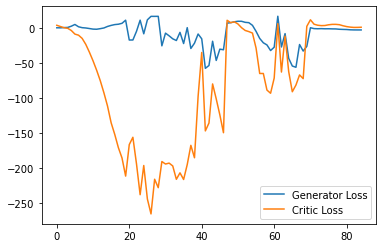

Step 1750: Generator loss: -3.6864520931243896, critic loss: 0.8321461381912231


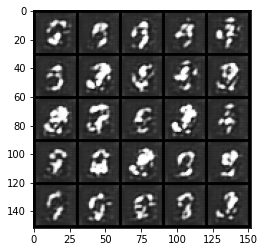

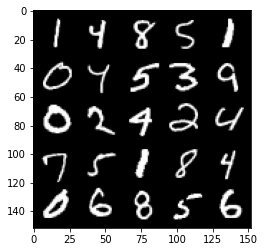

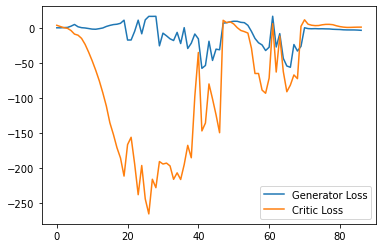

Step 1800: Generator loss: -4.056564769744873, critic loss: 1.2004202575683594


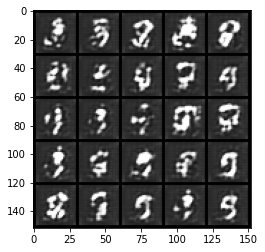

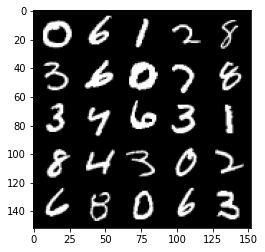

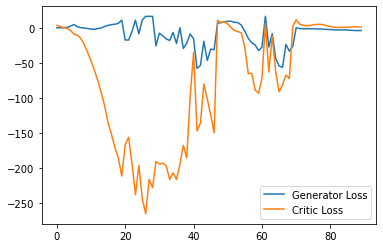

Step 1850: Generator loss: -4.859268293380738, critic loss: -0.06971030139923098


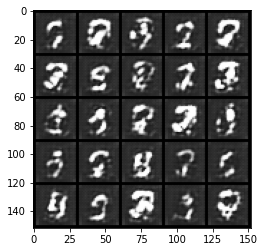

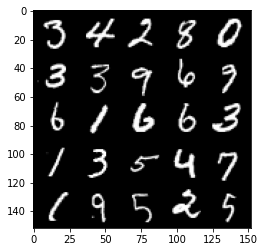

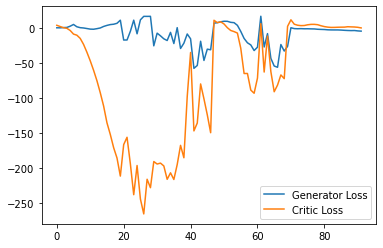

Step 1900: Generator loss: -5.702235565185547, critic loss: 0.4413877229690552


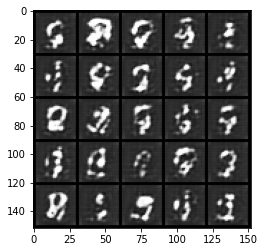

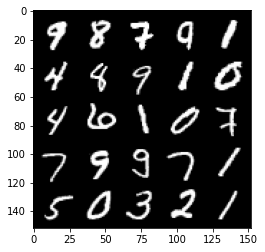

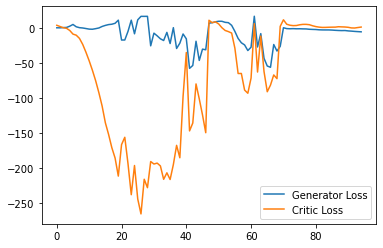

Step 1950: Generator loss: -7.703197917938232, critic loss: 0.6360901927947998


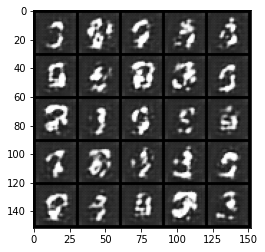

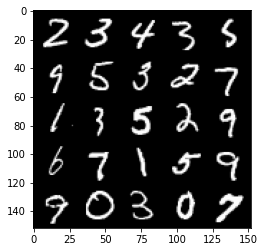

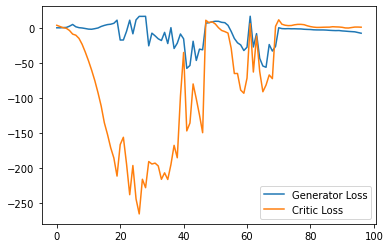

Step 2000: Generator loss: -10.571355743408203, critic loss: -0.7328273506164552


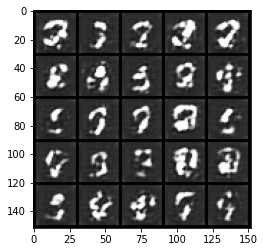

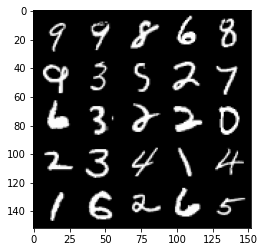

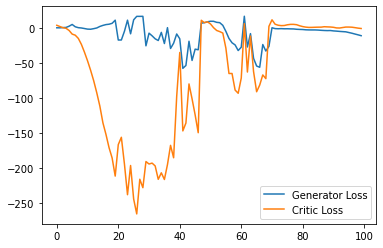

Step 2050: Generator loss: -13.323605308532715, critic loss: -1.8209932365417487


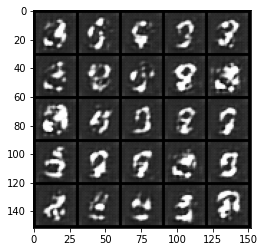

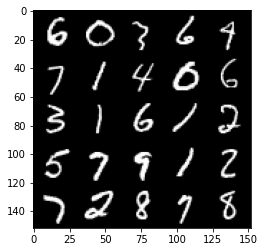

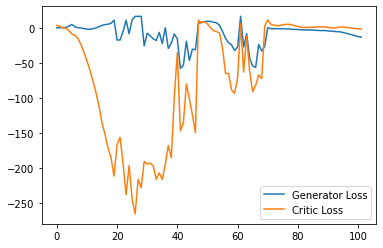

Step 2100: Generator loss: -14.891766262054443, critic loss: -3.3547163753509524


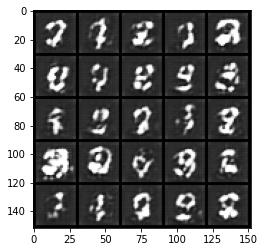

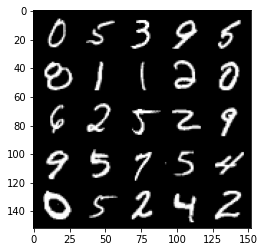

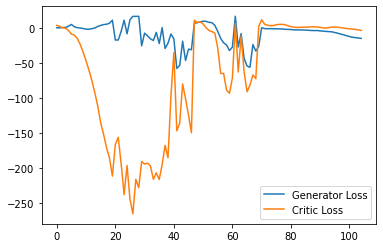

Step 2150: Generator loss: -15.95262191772461, critic loss: -5.357536619186402


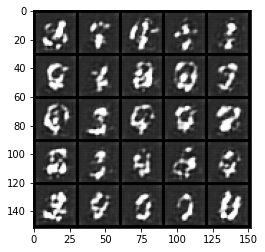

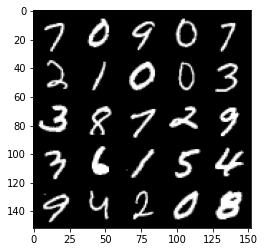

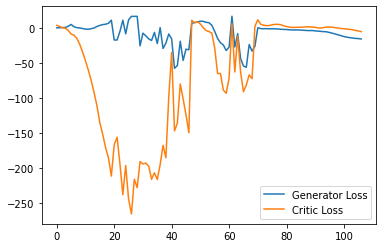

Step 2200: Generator loss: -17.95159730911255, critic loss: -7.933360528945923


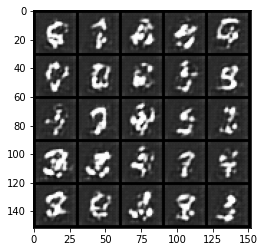

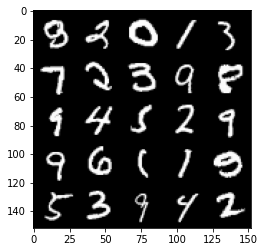

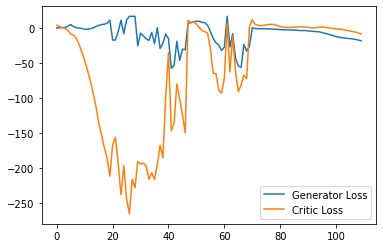

Step 2250: Generator loss: -20.852327117919923, critic loss: -11.211029401779173


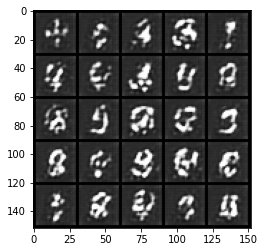

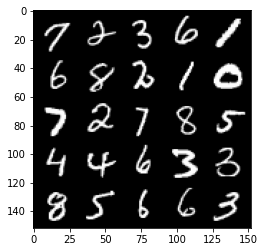

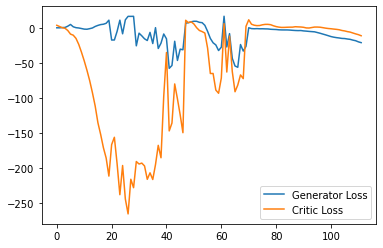

Step 2300: Generator loss: -21.76519805908203, critic loss: -16.56362714385986


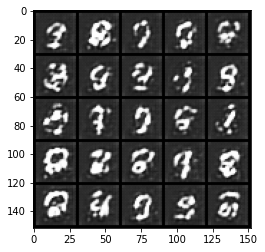

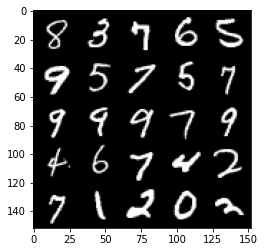

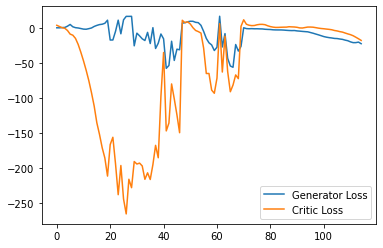

Step 2350: Generator loss: -23.033392181396483, critic loss: -21.134476917266852


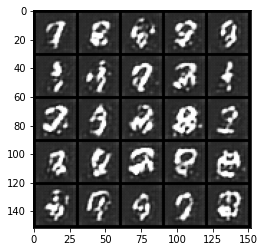

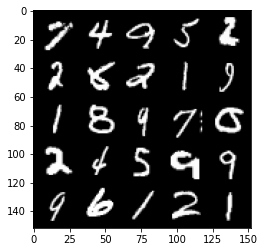

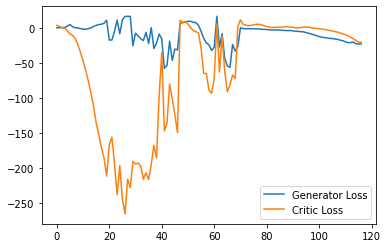

Step 2400: Generator loss: -22.49667234182358, critic loss: -24.589688299179073


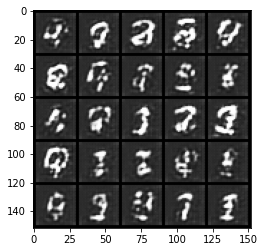

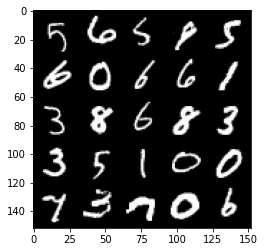

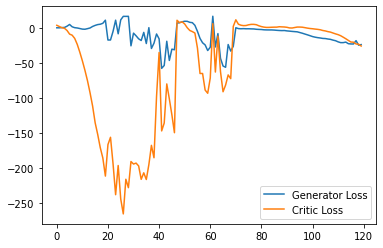

Step 2450: Generator loss: -23.192908973693847, critic loss: -28.926937408447266


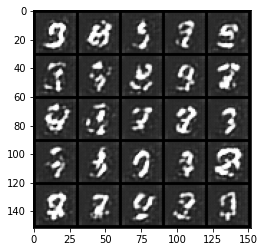

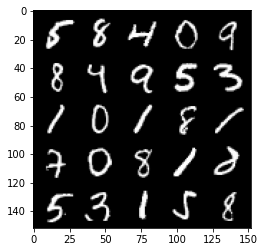

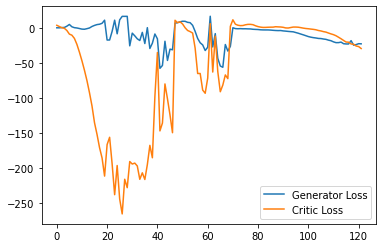

Step 2500: Generator loss: -22.885520648956298, critic loss: -32.11661531448364


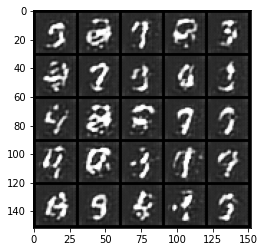

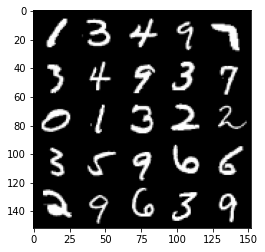

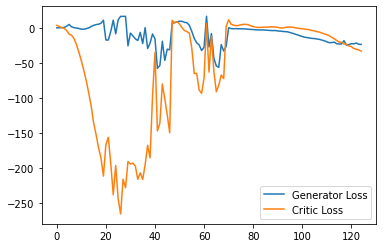

Step 2550: Generator loss: -25.88094659805298, critic loss: -34.138476139068615


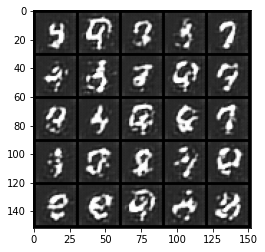

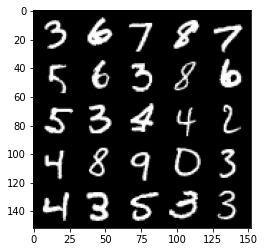

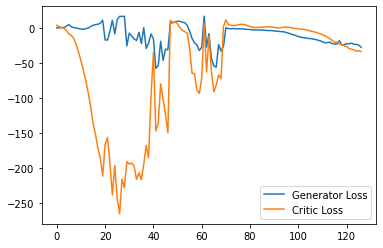

Step 2600: Generator loss: -28.001314907073976, critic loss: -35.863989715576174


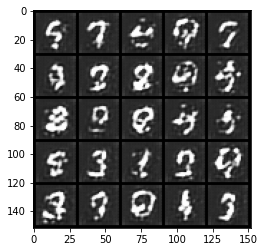

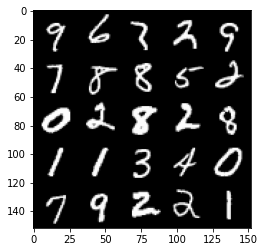

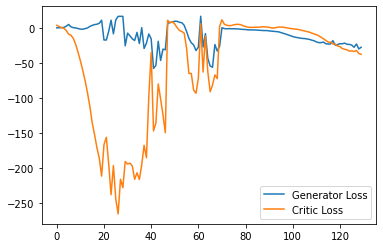

Step 2650: Generator loss: -32.478982276916504, critic loss: -39.14761778640747


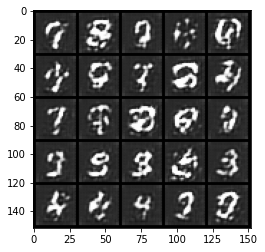

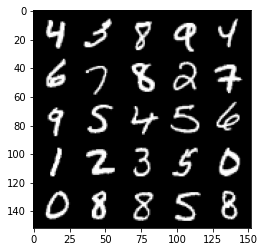

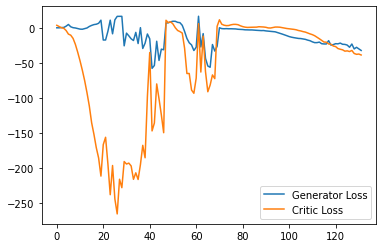

Step 2700: Generator loss: -33.898599491119384, critic loss: -39.526345783233644


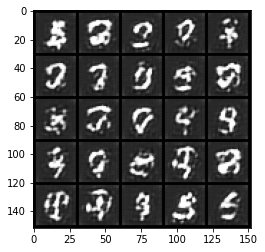

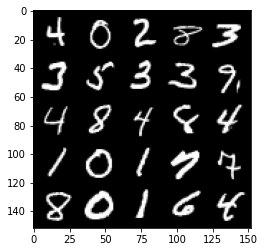

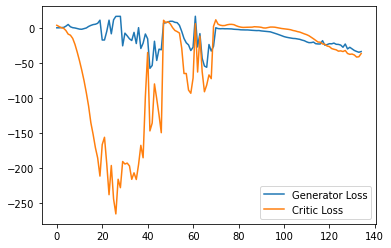

Step 2750: Generator loss: -32.01725023269653, critic loss: -39.07742314529419


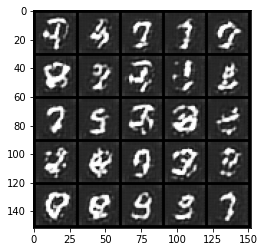

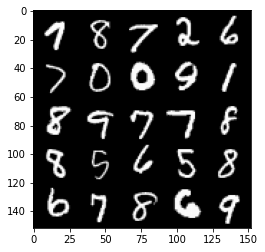

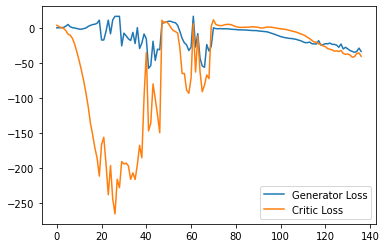

Step 2800: Generator loss: -34.7524089050293, critic loss: -37.63086144542694


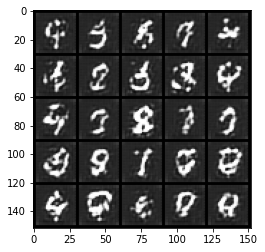

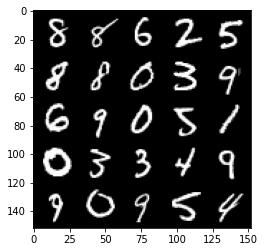

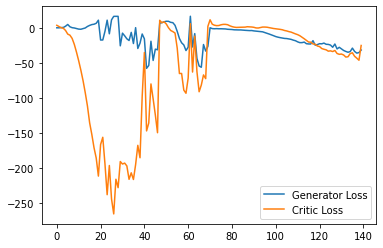

Step 2850: Generator loss: -38.411785202026365, critic loss: -43.18734273719786


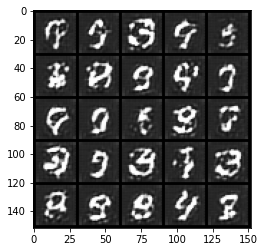

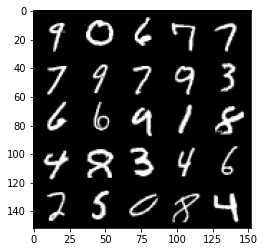

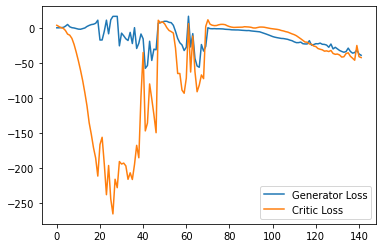

Step 2900: Generator loss: -40.445583724975585, critic loss: -44.30691835403442


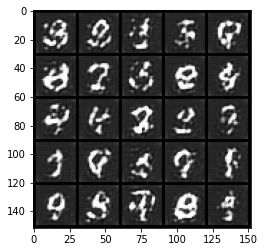

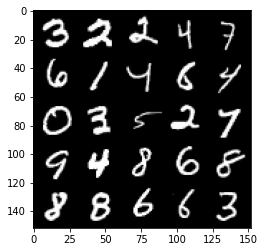

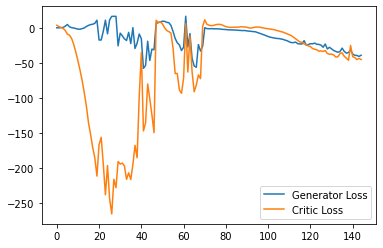

Step 2950: Generator loss: -42.77509544372558, critic loss: -44.67191970825196


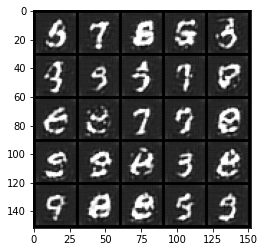

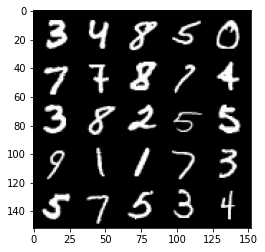

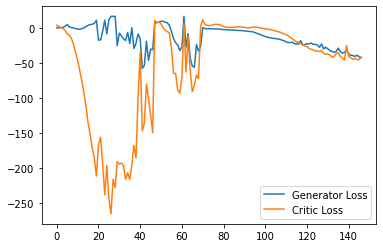

Step 3000: Generator loss: -41.64852593421936, critic loss: -42.510984632492054


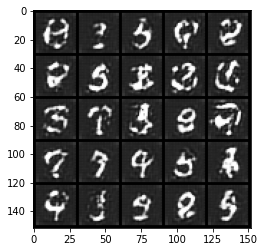

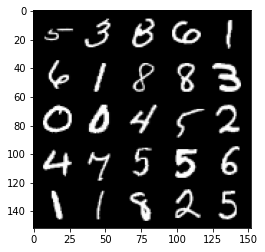

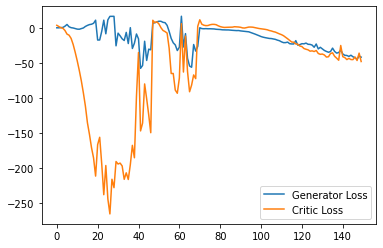

Step 3050: Generator loss: -44.492401142120364, critic loss: -37.872402280807506


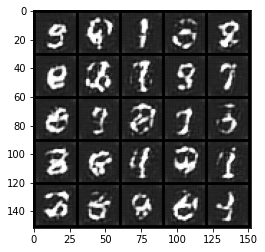

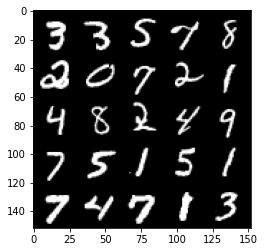

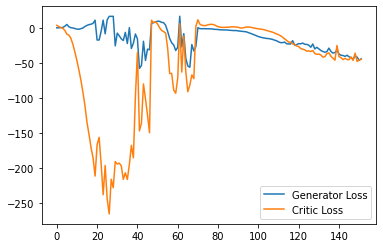

Step 3100: Generator loss: -40.8341846704483, critic loss: -42.32187460327148


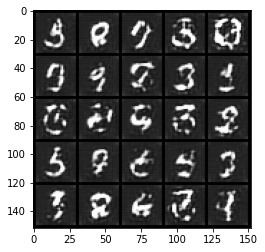

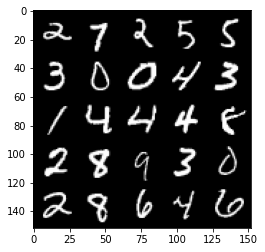

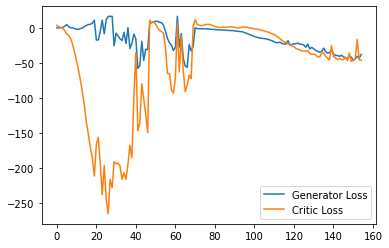

Step 3150: Generator loss: -46.23034381866455, critic loss: -48.080740242004374


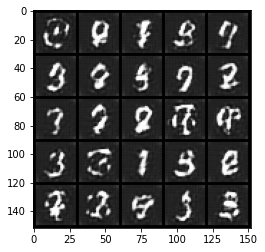

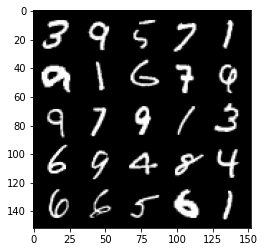

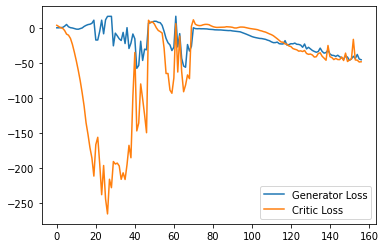

Step 3200: Generator loss: -43.27538692474365, critic loss: -31.3618776664734


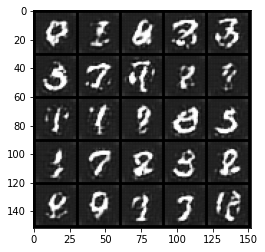

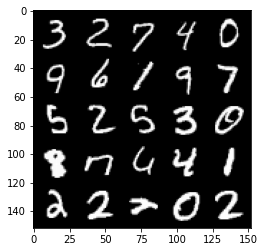

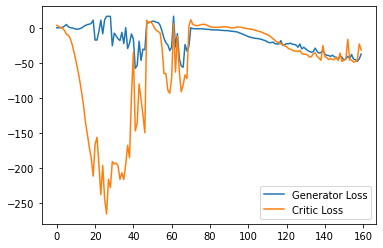

Step 3250: Generator loss: -46.357515754699705, critic loss: -45.74662800216675


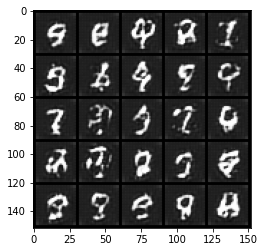

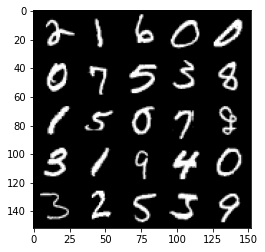

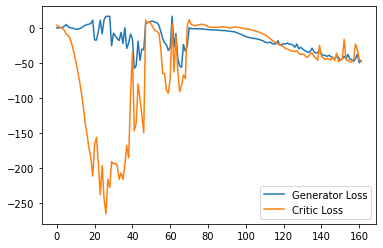

Step 3300: Generator loss: -51.86909660339356, critic loss: -45.70678962326049


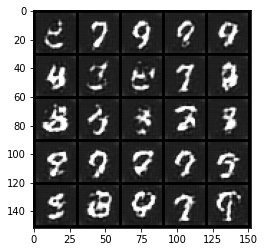

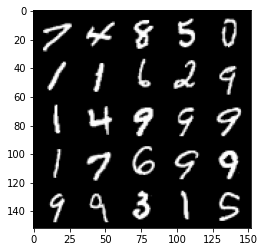

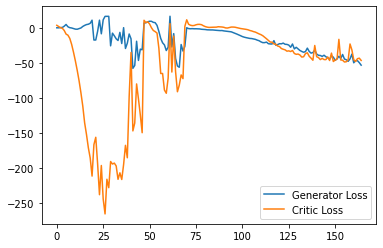

Step 3350: Generator loss: -46.742617206573485, critic loss: -38.44024877166748


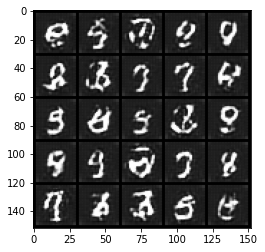

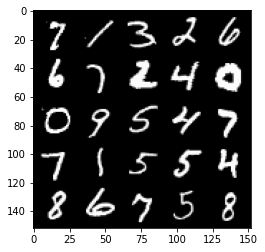

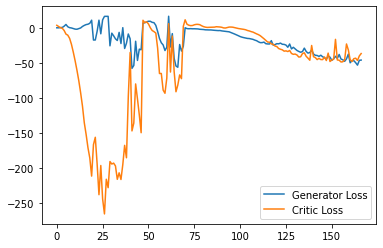

Step 3400: Generator loss: -54.230788497924806, critic loss: -44.28236877441406


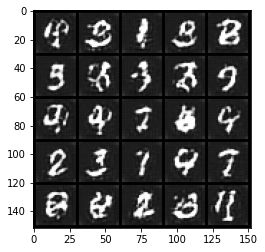

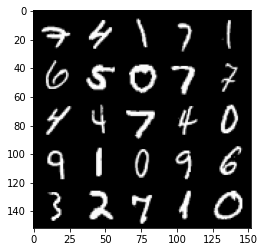

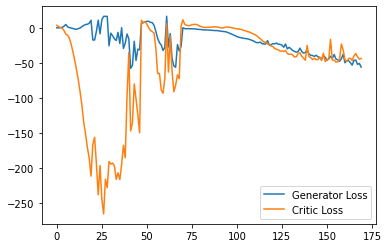

Step 3450: Generator loss: -51.01416347503662, critic loss: -43.323676025390625


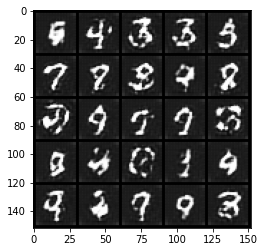

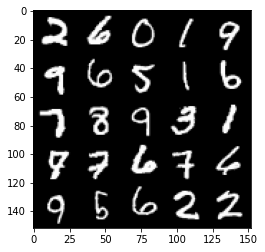

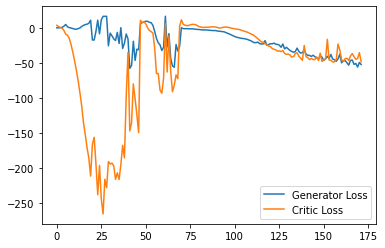

Step 3500: Generator loss: -50.40484436035156, critic loss: -24.256622339248658


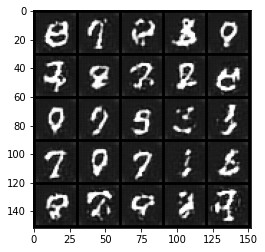

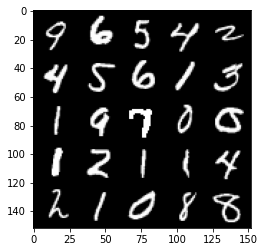

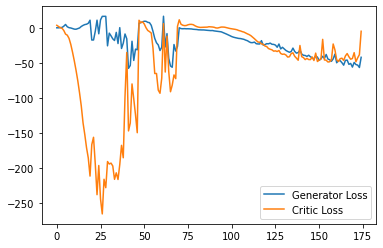

Step 3550: Generator loss: -47.342684478759764, critic loss: -28.530678096771236


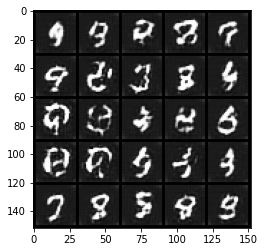

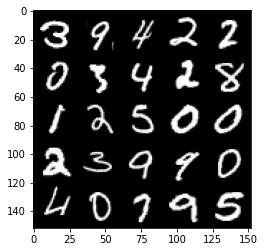

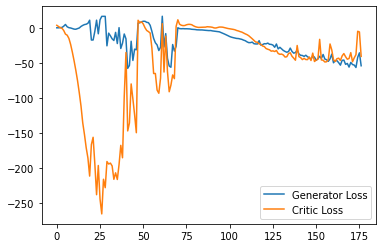

Step 3600: Generator loss: -56.176962509155274, critic loss: -39.40775035095215


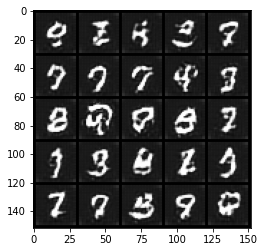

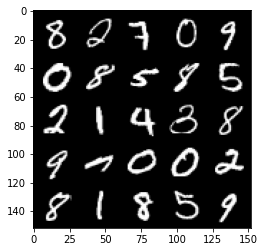

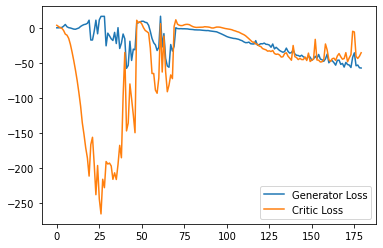

Step 3650: Generator loss: -53.44210708618164, critic loss: -32.76066764640808


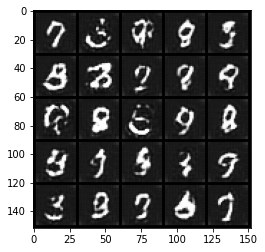

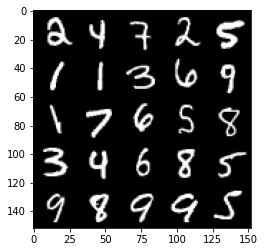

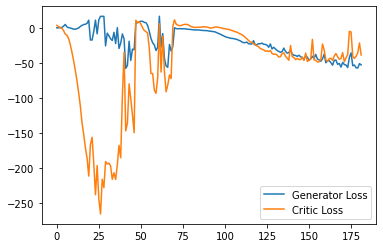

Step 3700: Generator loss: -53.39635623931885, critic loss: -28.801539663314824


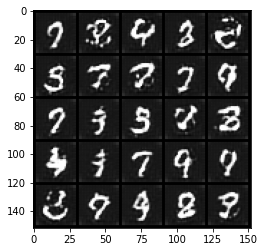

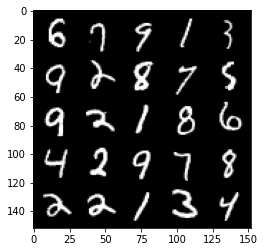

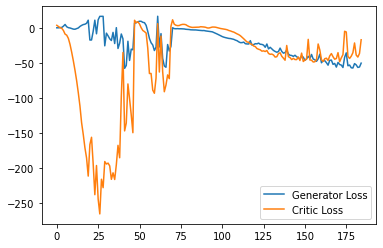

Step 3750: Generator loss: -38.774793548583986, critic loss: -3.614678034305572


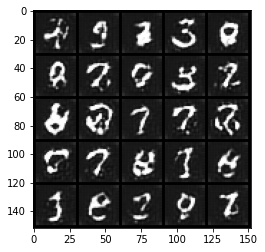

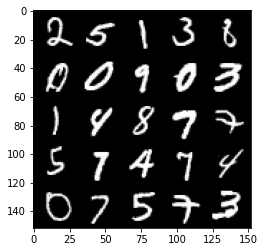

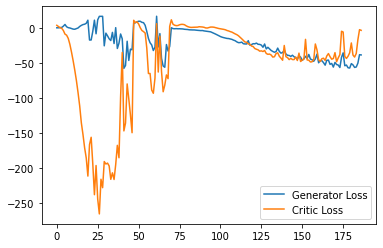

Step 3800: Generator loss: -52.07379150390625, critic loss: -23.44898360824584


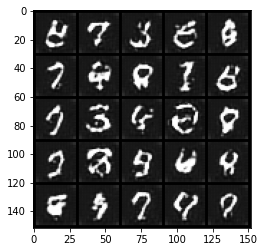

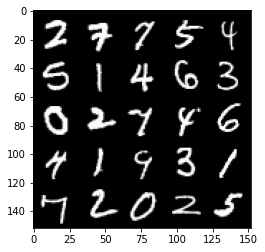

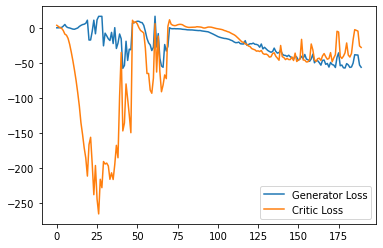

Step 3850: Generator loss: -55.21931503295898, critic loss: -35.90934631729126


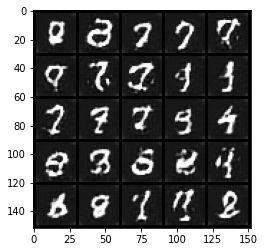

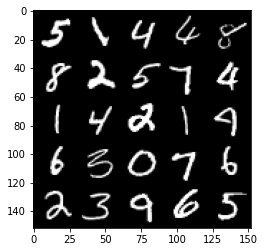

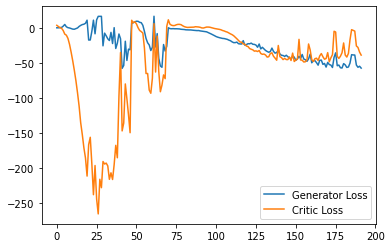

Step 3900: Generator loss: -48.70375099182129, critic loss: -19.837840180397034


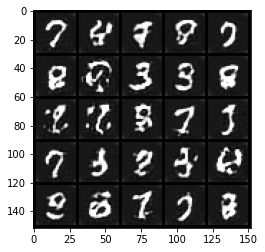

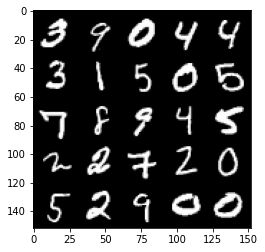

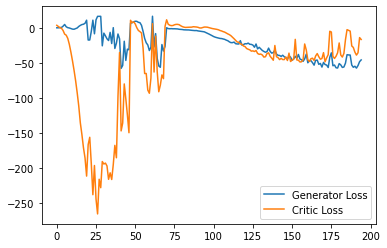

Step 3950: Generator loss: -56.52320381164551, critic loss: -35.311343933105476


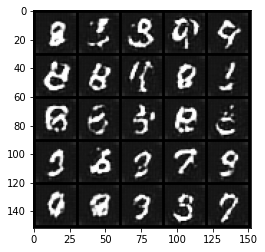

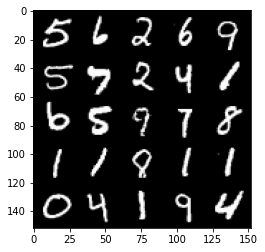

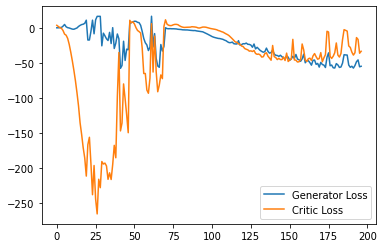

Step 4000: Generator loss: -50.40554176330566, critic loss: -6.7571748924255335


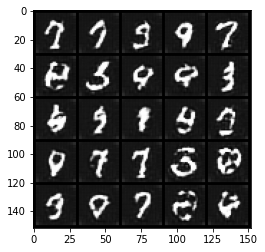

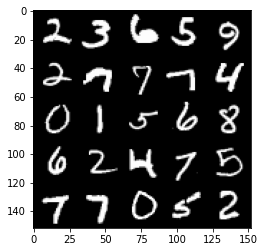

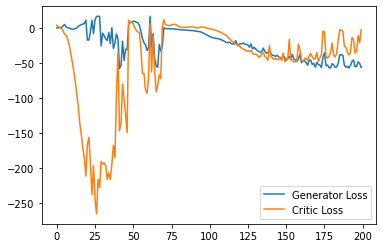

Step 4050: Generator loss: -36.817483825683595, critic loss: -1.2811194100379943


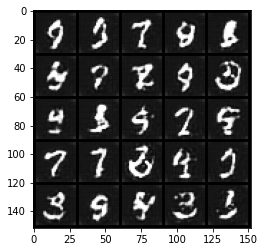

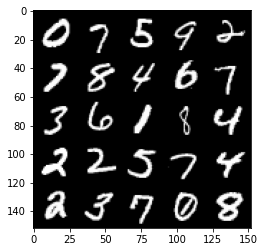

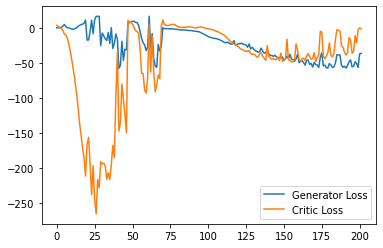

Step 4100: Generator loss: -37.33840072631836, critic loss: -2.0304798889160165


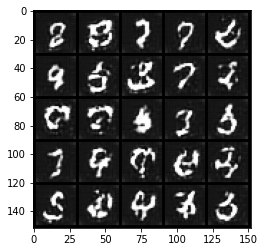

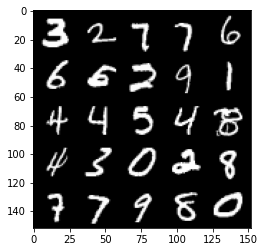

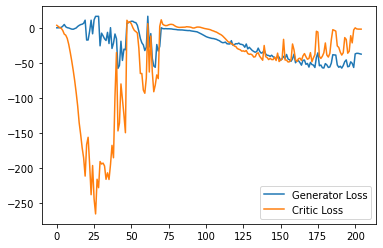

Step 4150: Generator loss: -38.42483070373535, critic loss: -2.282689700603485


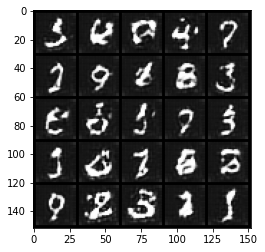

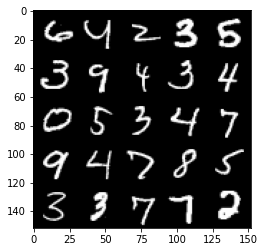

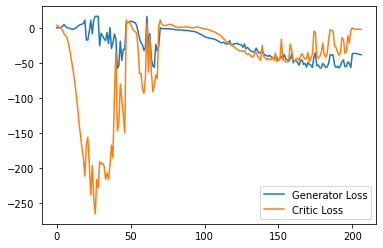

Step 4200: Generator loss: -39.16989418029785, critic loss: -2.7299458017349254


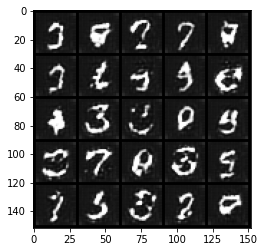

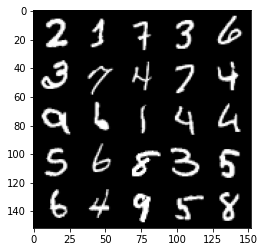

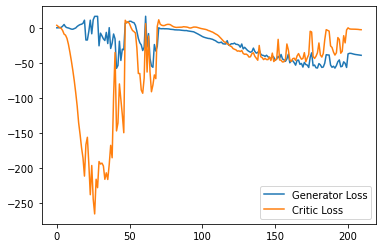

Step 4250: Generator loss: -40.50206916809082, critic loss: -3.112319932937622


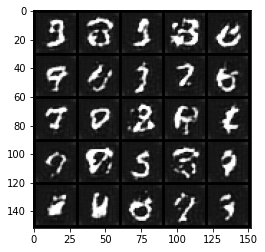

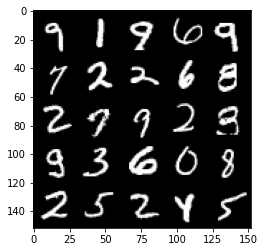

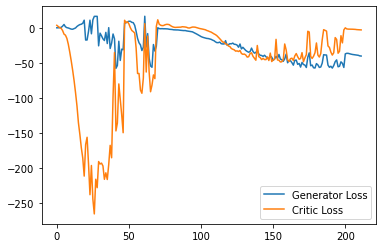

Step 4300: Generator loss: -41.29573951721191, critic loss: -4.221276312828064


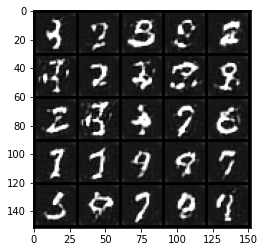

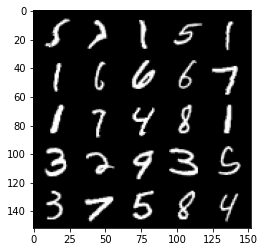

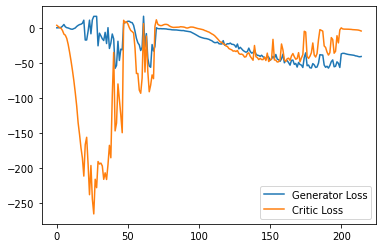

Step 4350: Generator loss: -45.49314842224121, critic loss: -4.019673605442046


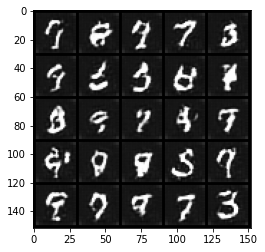

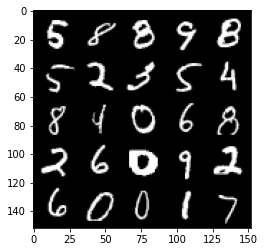

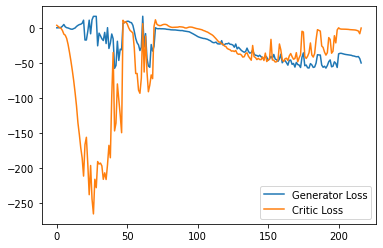

Step 4400: Generator loss: -40.07892997741699, critic loss: -2.1930839715003967


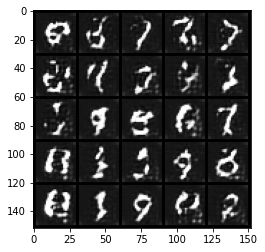

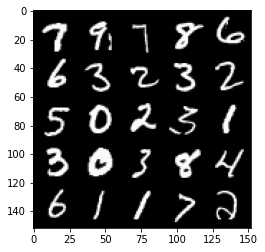

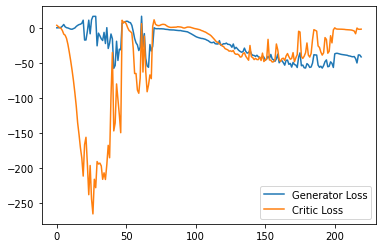

Step 4450: Generator loss: -44.03926574707031, critic loss: -2.7775136198997488


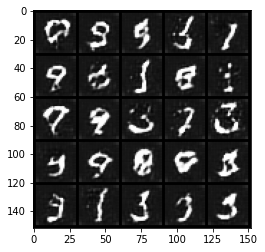

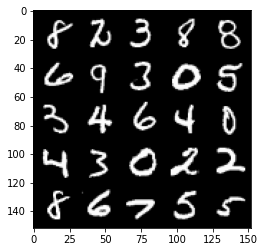

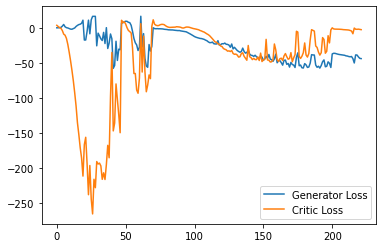

Step 4500: Generator loss: -45.96974128723144, critic loss: -3.752447288513185


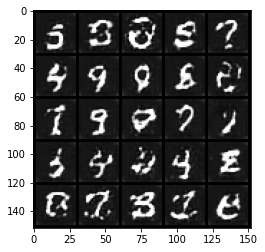

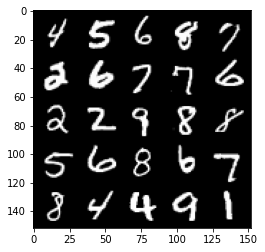

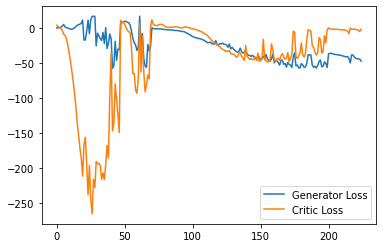

Step 4550: Generator loss: -44.152652740478516, critic loss: -4.934616597175598


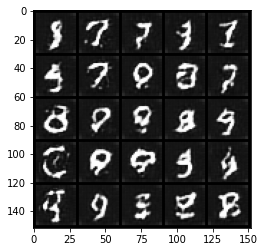

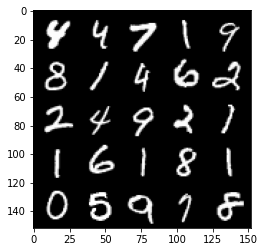

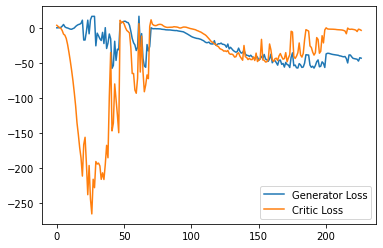

Step 4600: Generator loss: -48.77117942810059, critic loss: -5.562395517349241


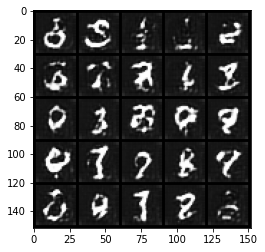

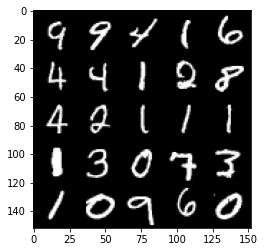

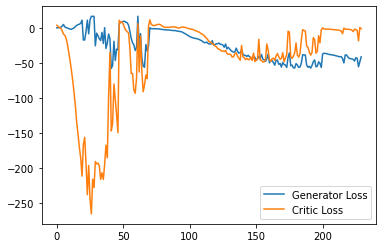

Step 4650: Generator loss: -44.16740104675293, critic loss: -1.6816985249519352


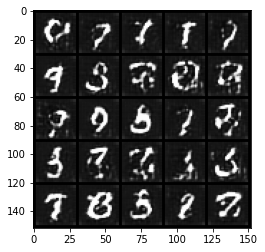

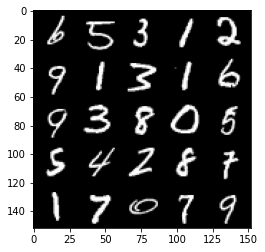

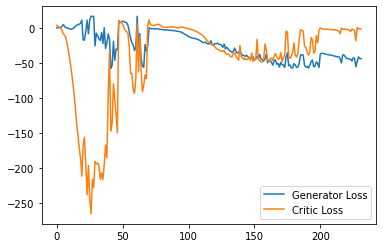

Step 4700: Generator loss: -44.36241325378418, critic loss: -2.0392786536216736


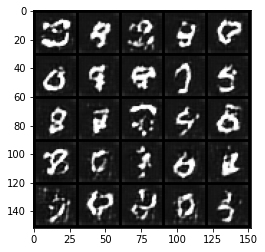

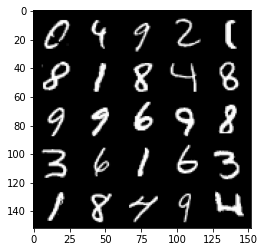

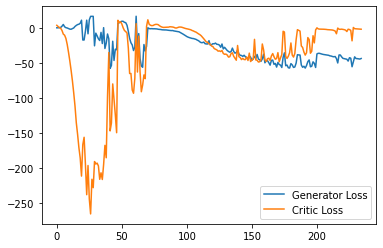

Step 4750: Generator loss: -44.95195610046387, critic loss: -2.6257821159362793


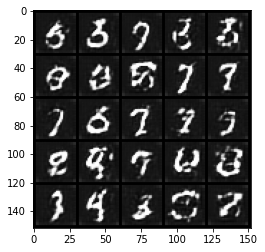

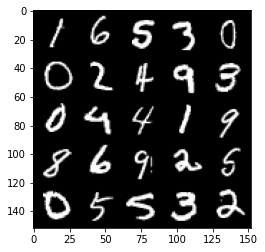

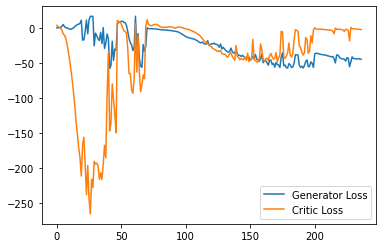

Step 4800: Generator loss: -45.01954444885254, critic loss: -3.95853691482544


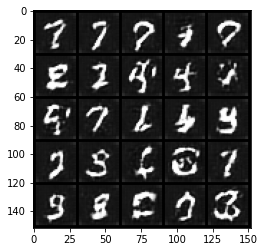

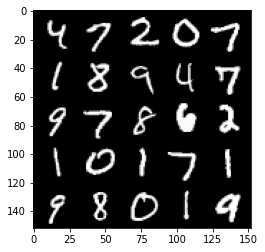

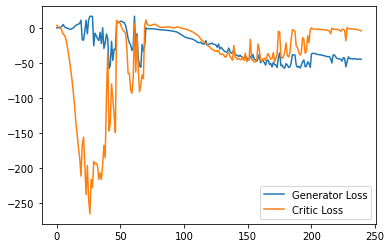

Step 4850: Generator loss: -43.90242088317871, critic loss: -2.624527625083923


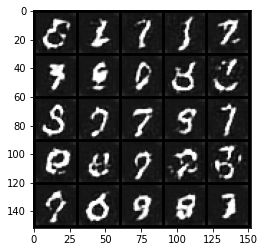

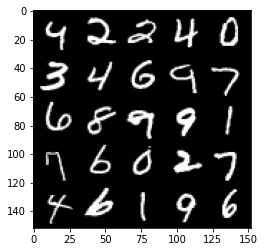

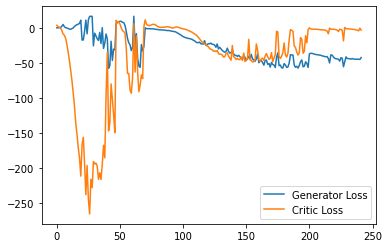

Step 4900: Generator loss: -45.31167671203613, critic loss: -4.910878537654878


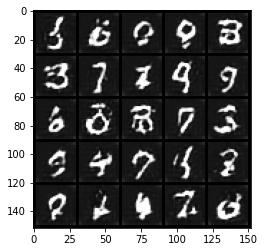

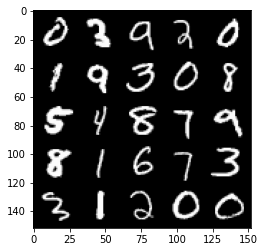

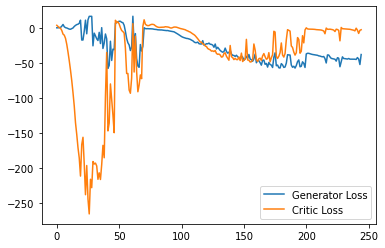

Step 4950: Generator loss: -40.49586639404297, critic loss: -3.4485235004425054


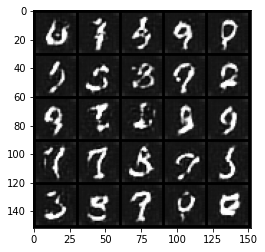

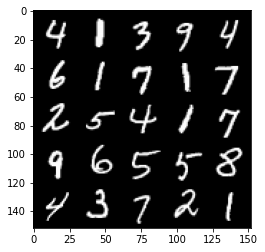

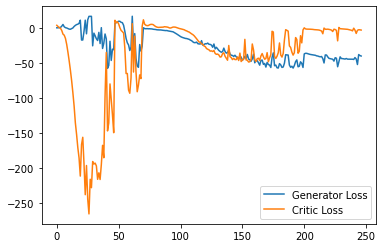

Step 5000: Generator loss: -47.7182795715332, critic loss: -8.548662988185878


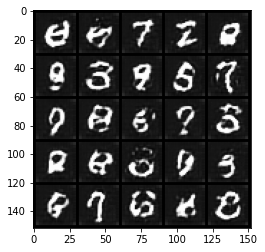

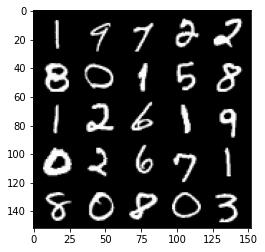

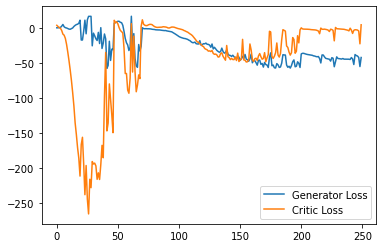

Step 5050: Generator loss: -38.637808074951174, critic loss: -2.993335634231568


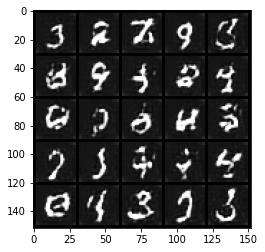

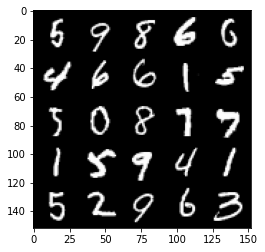

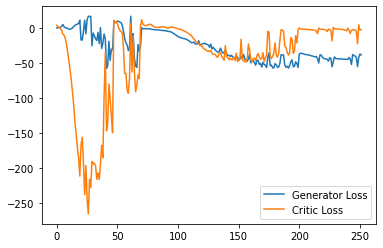

Step 5100: Generator loss: -46.94397346496582, critic loss: -12.563427138328553


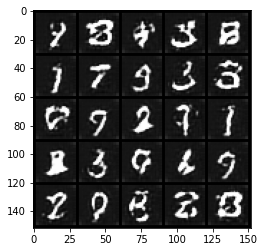

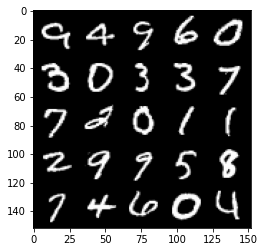

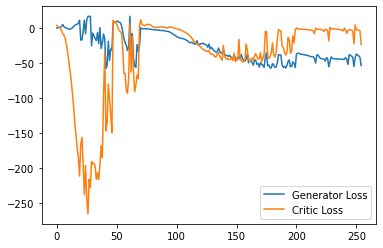

Step 5150: Generator loss: -41.495925674438475, critic loss: -3.126475676536558


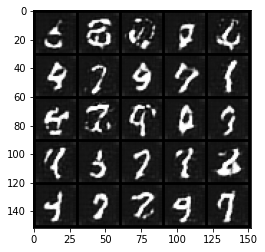

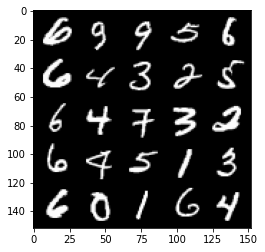

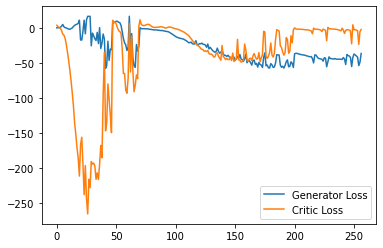

Step 5200: Generator loss: -38.78873260498047, critic loss: -2.616959321022033


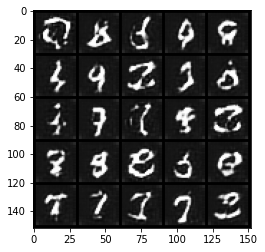

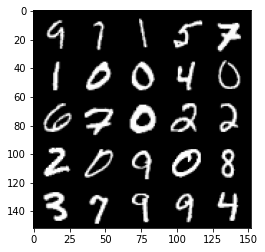

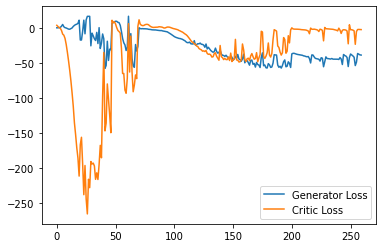

Step 5250: Generator loss: -40.551162033081056, critic loss: -3.409148798942566


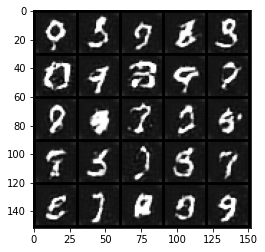

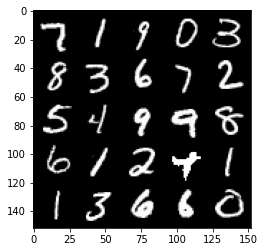

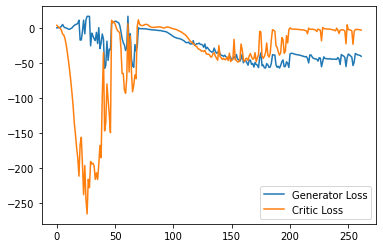

Step 5300: Generator loss: -47.273570709228515, critic loss: -8.842369287014009


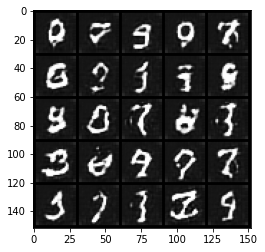

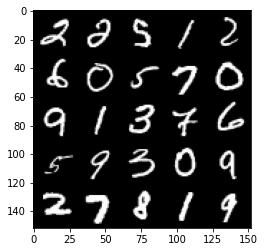

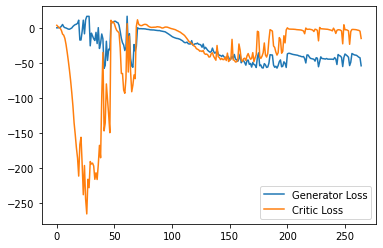

Step 5350: Generator loss: -38.334018020629884, critic loss: -3.332150665283204


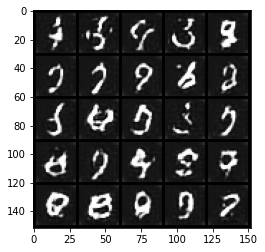

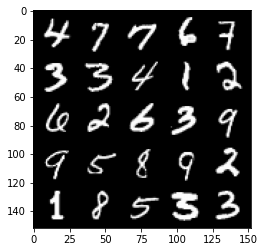

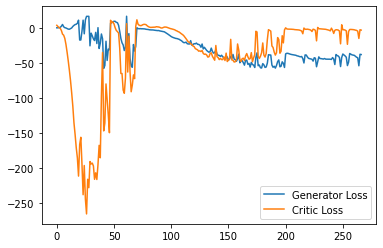

Step 5400: Generator loss: -49.65316722869873, critic loss: -16.362381325721746


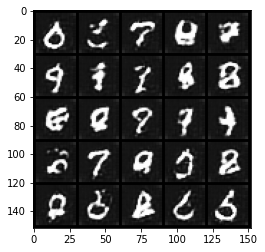

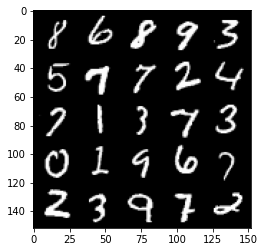

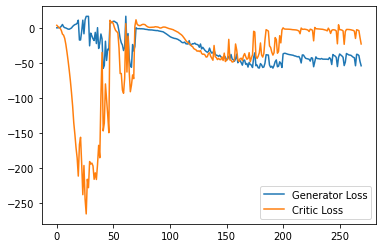

Step 5450: Generator loss: -39.67696084976196, critic loss: -1.4998118634223931


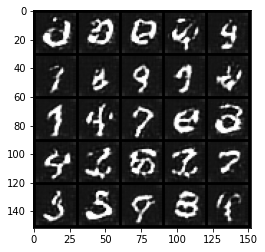

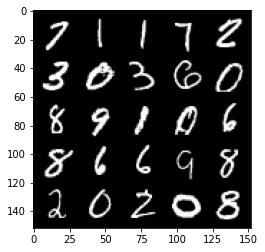

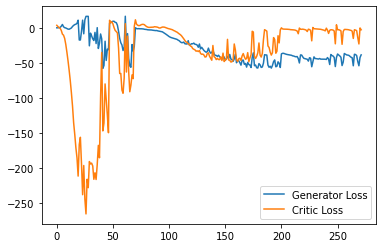

Step 5500: Generator loss: -40.136286697387696, critic loss: -3.959609128952026


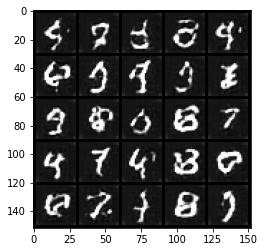

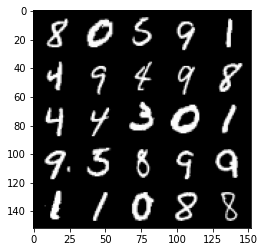

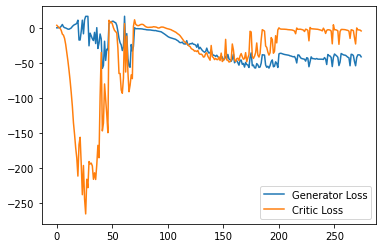

Step 5550: Generator loss: -55.116075630187986, critic loss: -24.870733119964612


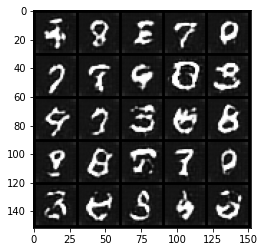

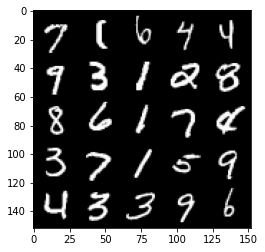

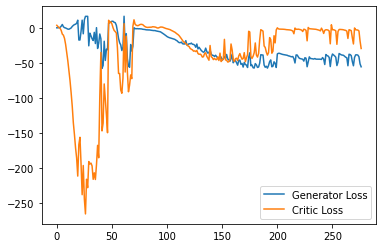

Step 5600: Generator loss: -55.95219093322754, critic loss: -29.30473044300079


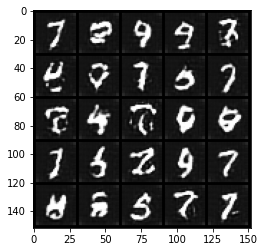

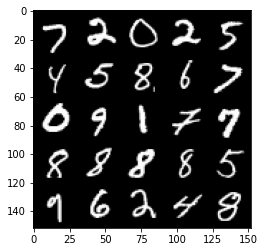

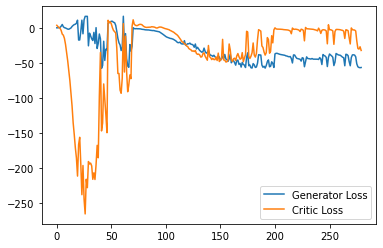

Step 5650: Generator loss: -41.341692771911625, critic loss: 4.476856021881104


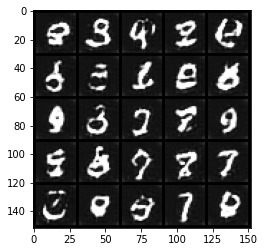

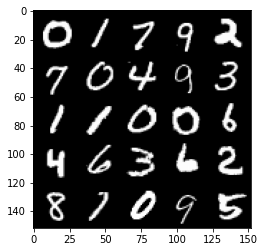

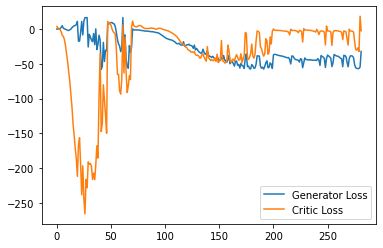

Step 5700: Generator loss: -35.51096466064453, critic loss: -2.783086158752442


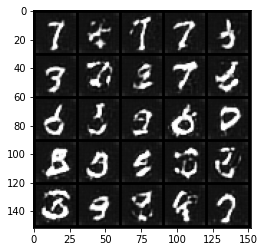

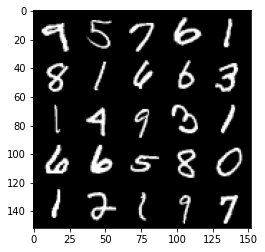

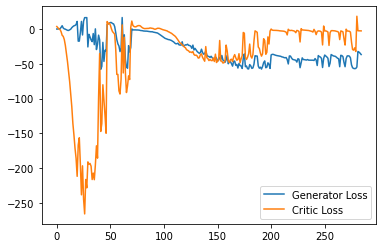

Step 5750: Generator loss: -39.56458534240723, critic loss: -3.4340223650932327


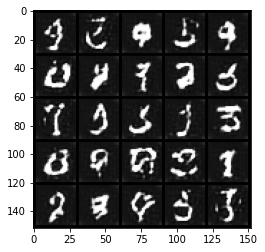

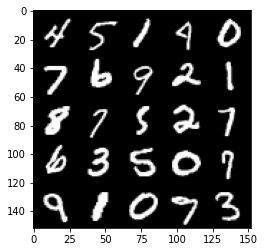

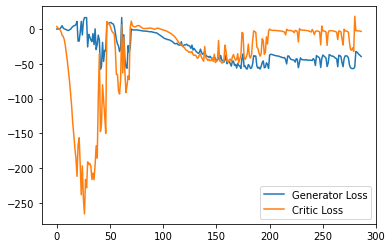

Step 5800: Generator loss: -43.887397842407225, critic loss: -5.308745032548903


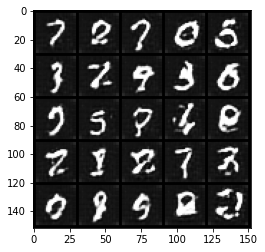

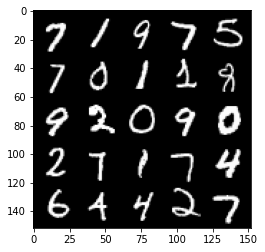

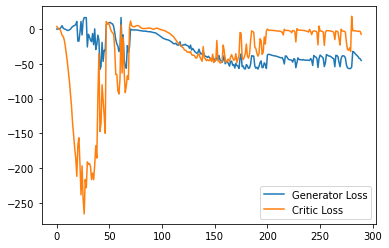

Step 5850: Generator loss: -50.80331985473633, critic loss: -18.974640739917756


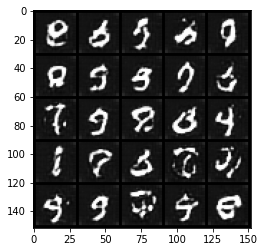

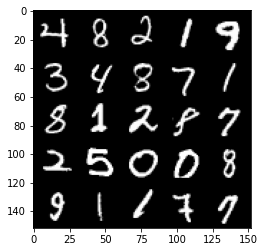

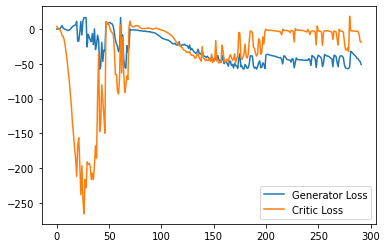

Step 5900: Generator loss: -40.556337127685545, critic loss: 5.31215395307541


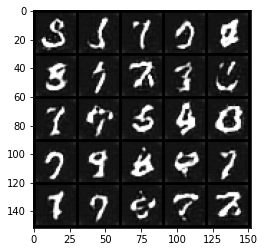

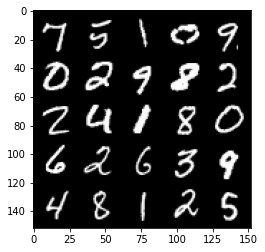

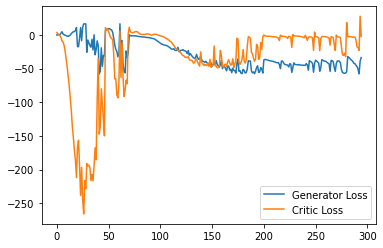

Step 5950: Generator loss: -36.56080078125, critic loss: -2.2803629474639884


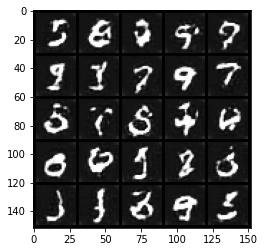

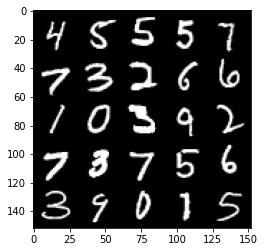

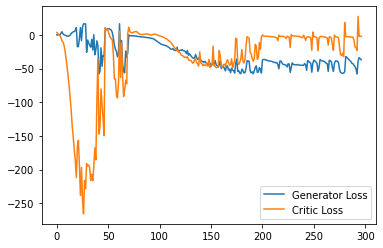

Step 6000: Generator loss: -37.977027893066406, critic loss: -2.3967267661094667


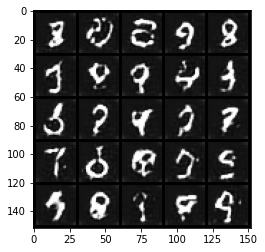

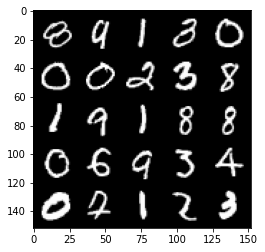

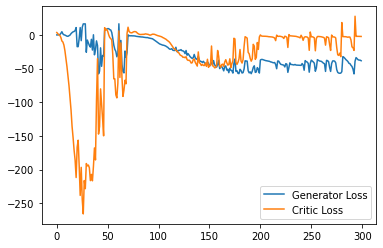

Step 6050: Generator loss: -39.67455169677734, critic loss: -2.66603809928894


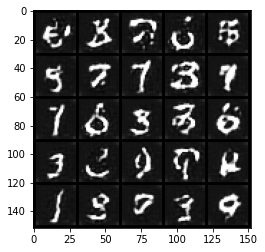

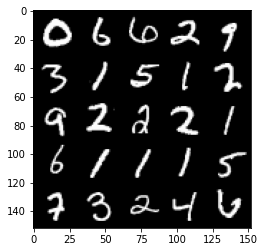

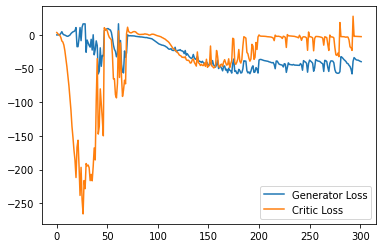

Step 6100: Generator loss: -41.22582954406738, critic loss: -2.911406904220582


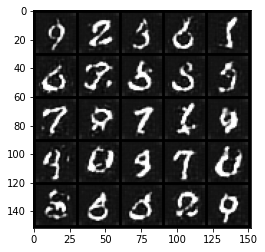

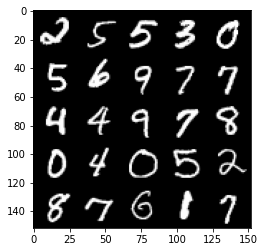

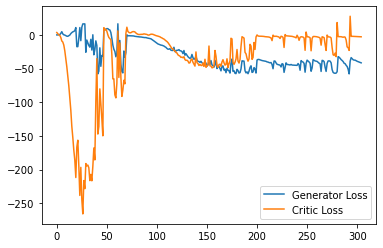

Step 6150: Generator loss: -41.09208320617676, critic loss: -3.4818534431457517


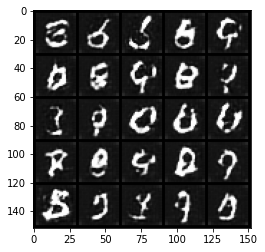

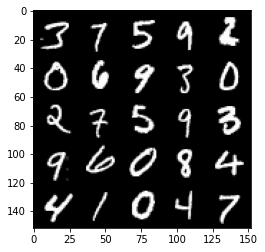

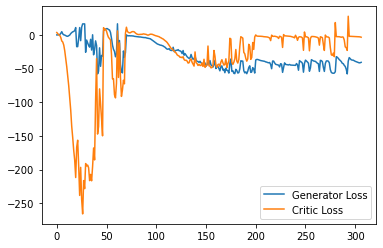

Step 6200: Generator loss: -47.55459861755371, critic loss: -12.849306525230409


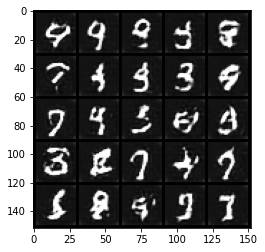

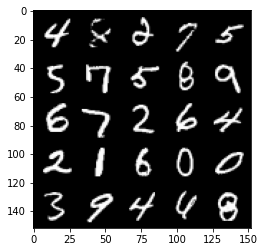

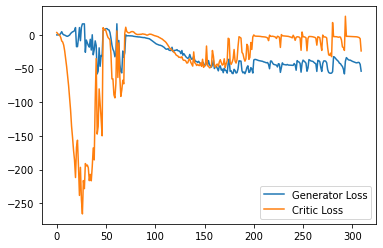

Step 6250: Generator loss: -54.932858276367185, critic loss: -20.719243833541864


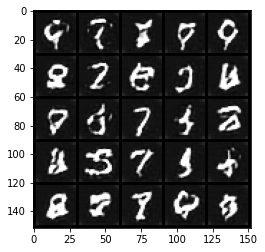

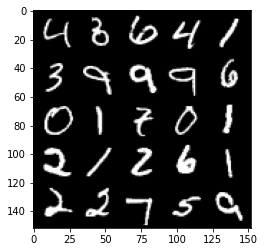

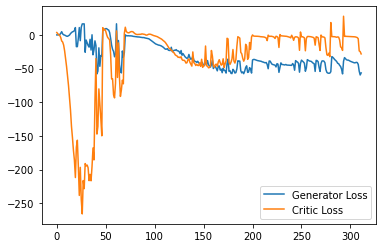

Step 6300: Generator loss: -43.069242324829105, critic loss: -14.347016885757446


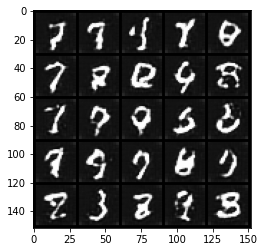

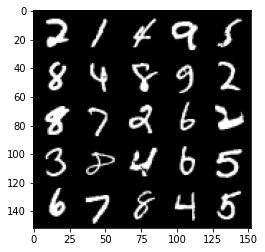

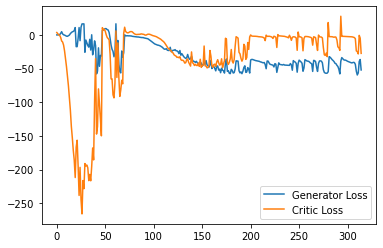

Step 6350: Generator loss: -44.112392349243166, critic loss: 2.2689556241035467


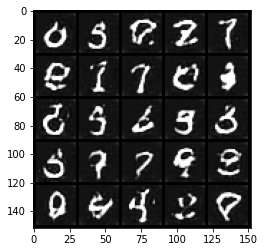

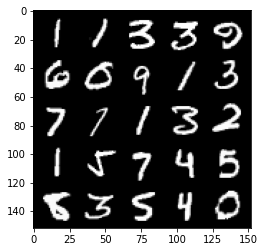

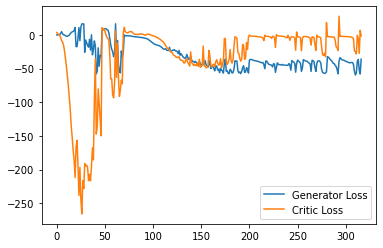

Step 6400: Generator loss: -35.93085525512695, critic loss: -2.039544737815857


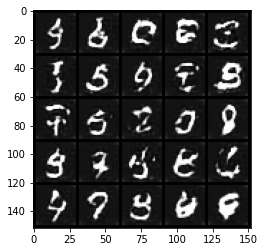

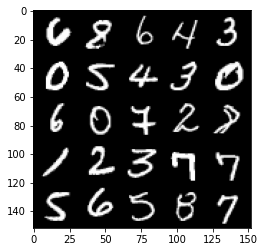

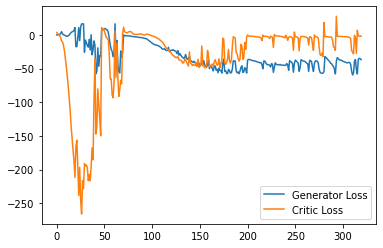

Step 6450: Generator loss: -37.86935287475586, critic loss: -2.040855021953583


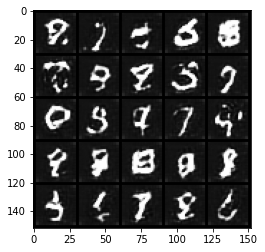

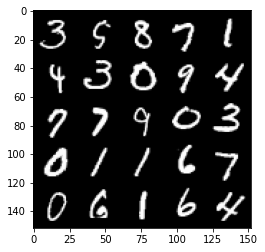

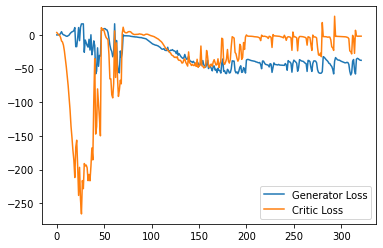

Step 6500: Generator loss: -39.06876693725586, critic loss: -2.1291491737365718


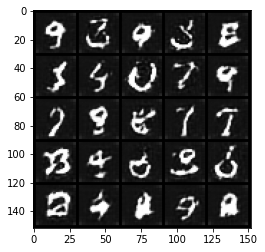

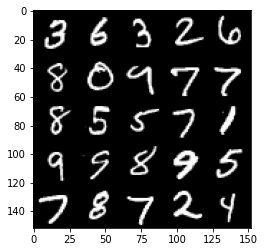

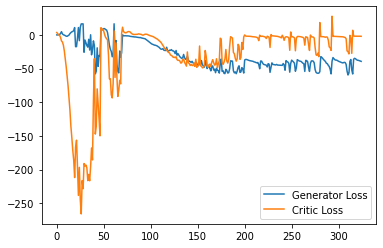

Step 6550: Generator loss: -40.20269798278809, critic loss: -2.3322571091651922


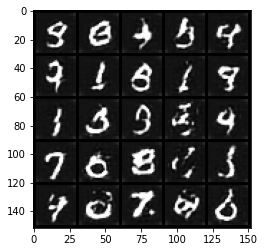

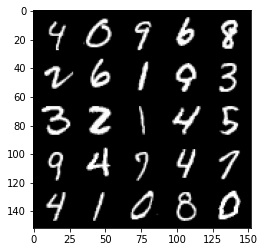

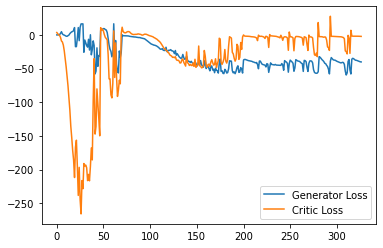

Step 6600: Generator loss: -40.85713714599609, critic loss: -2.503133655071258


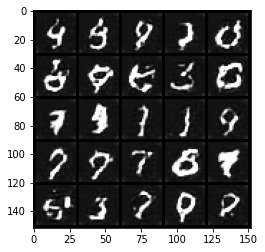

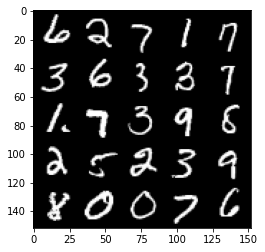

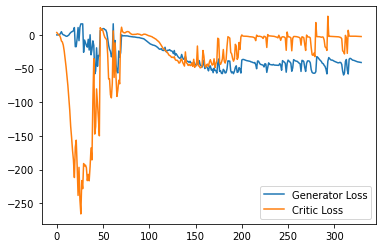

Step 6650: Generator loss: -41.48125961303711, critic loss: -2.673409157752991


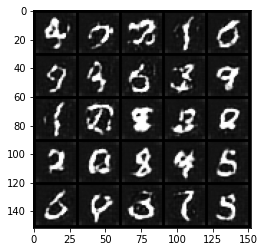

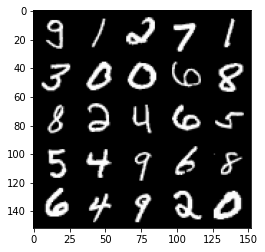

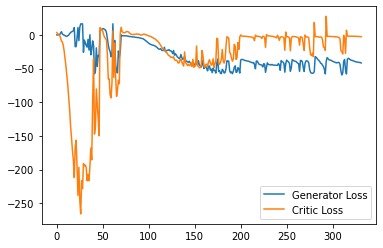

Step 6700: Generator loss: -41.851701431274414, critic loss: -2.768282661437988


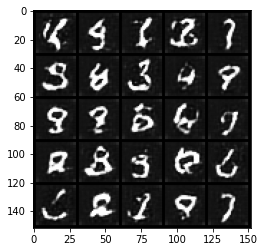

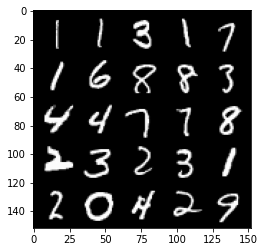

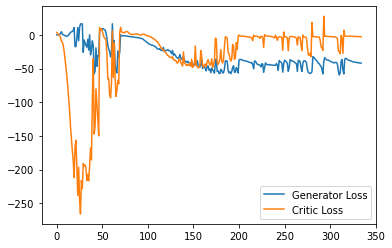

Step 6750: Generator loss: -42.08202033996582, critic loss: -3.334129058837891


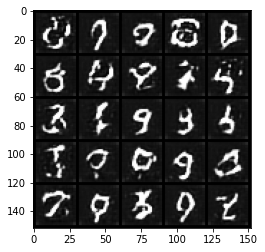

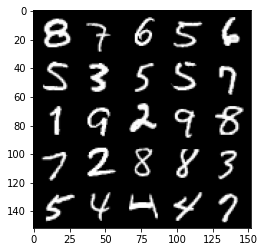

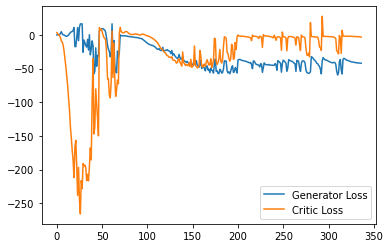

Step 6800: Generator loss: -44.713453979492186, critic loss: -6.167233948707579


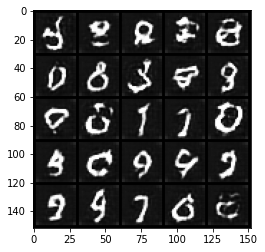

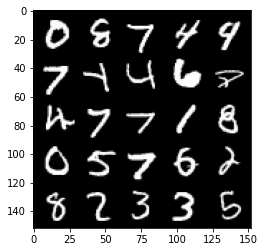

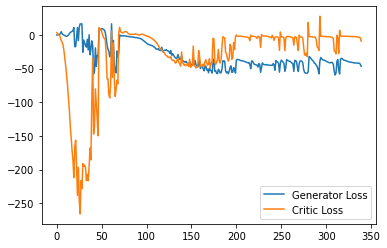

Step 6850: Generator loss: -40.70289604187012, critic loss: -1.0730015621185307


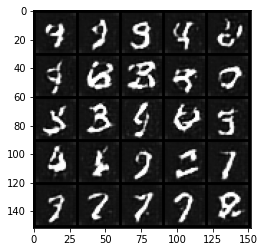

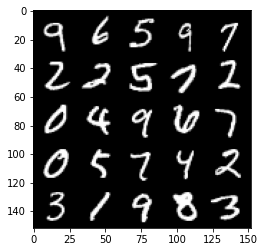

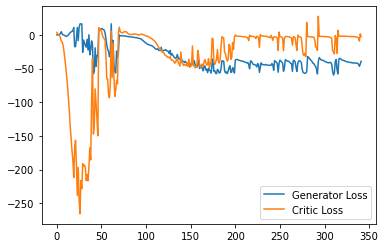

Step 6900: Generator loss: -44.27000144958496, critic loss: -8.022756144523623


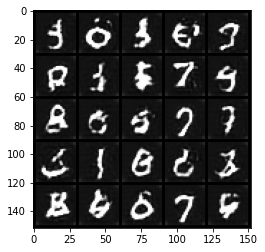

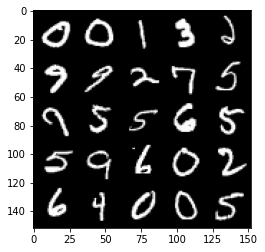

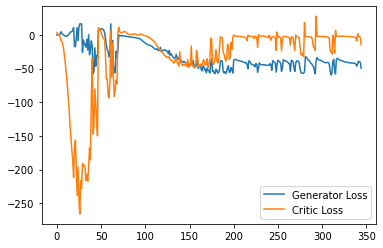

Step 6950: Generator loss: -38.14279161453247, critic loss: 2.5130663805007942


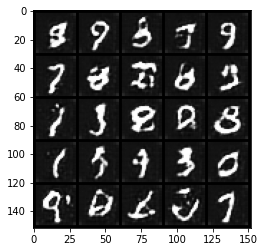

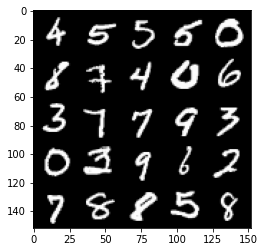

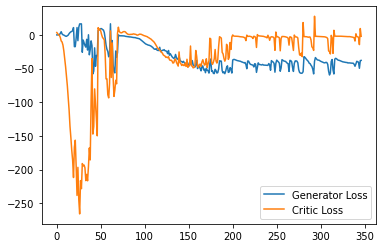

Step 7000: Generator loss: -39.431019439697266, critic loss: -2.373660256385803


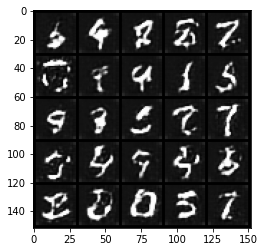

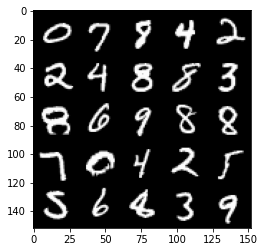

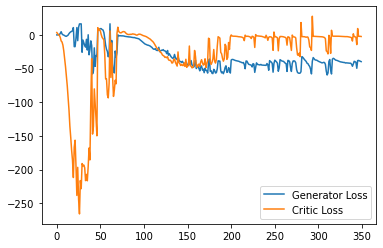

Step 7050: Generator loss: -41.21273132324219, critic loss: -2.8685101089477545


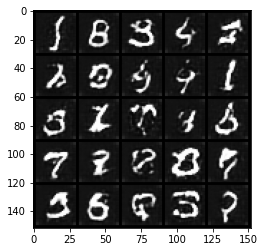

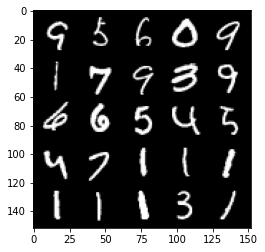

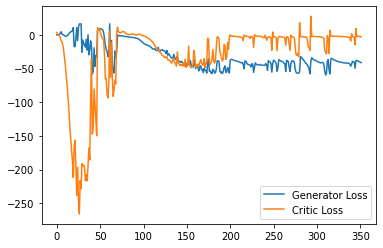

Step 7100: Generator loss: -42.20272552490234, critic loss: -3.519276660919188


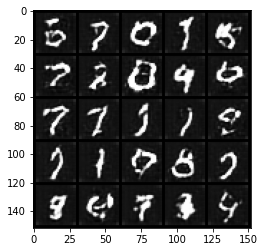

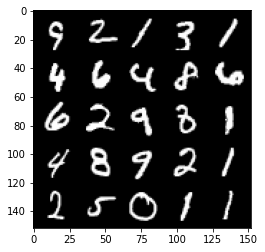

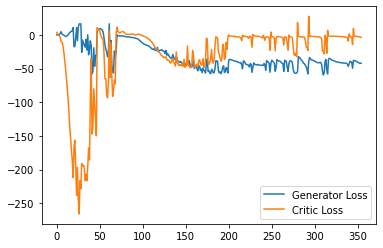

Step 7150: Generator loss: -52.90702651977539, critic loss: -15.090968914031983


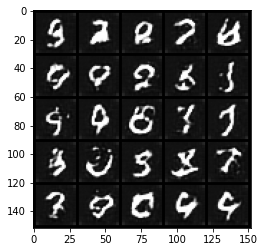

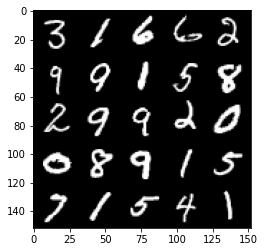

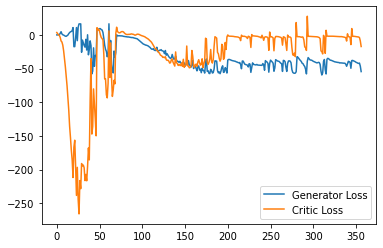

Step 7200: Generator loss: -48.00147445678711, critic loss: -17.675617090225227


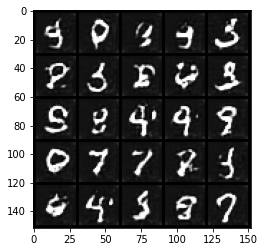

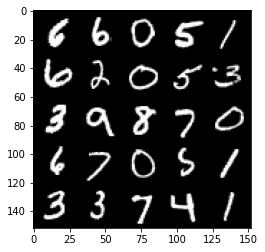

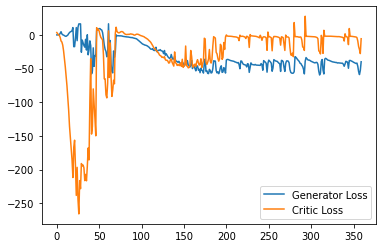

Step 7250: Generator loss: -44.09466033935547, critic loss: -14.865599286079407


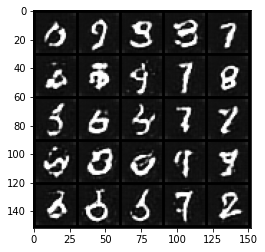

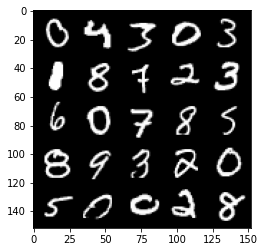

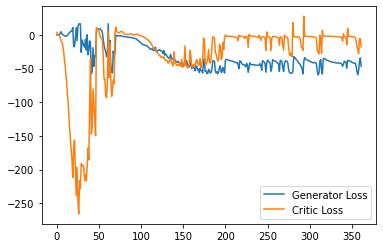

Step 7300: Generator loss: -45.634884452819826, critic loss: -22.287715363502503


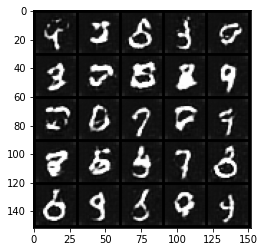

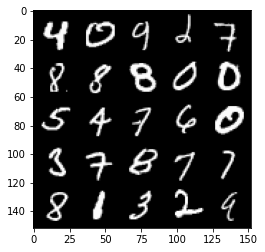

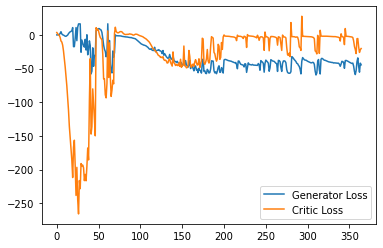

Step 7350: Generator loss: -36.98902858734131, critic loss: 6.860710798263551


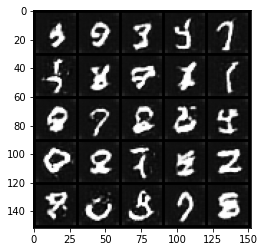

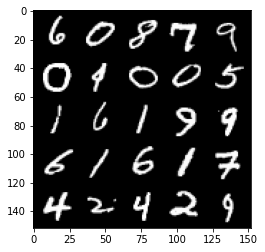

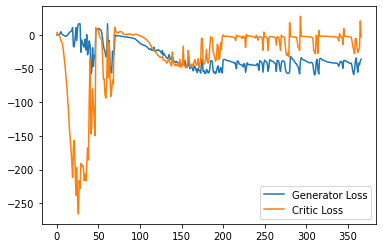

Step 7400: Generator loss: -38.50190589904785, critic loss: -3.258040531158448


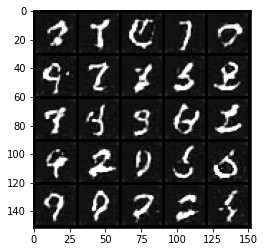

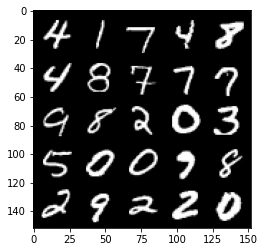

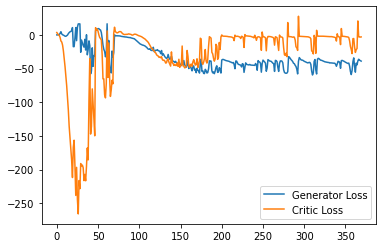

Step 7450: Generator loss: -37.91235664367676, critic loss: -3.6549403839111316


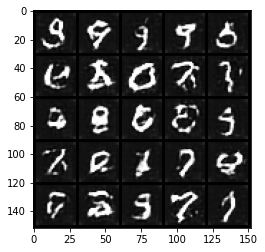

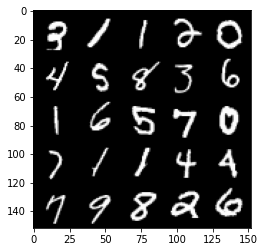

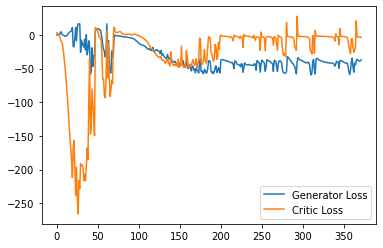

Step 7500: Generator loss: -48.87647331237793, critic loss: -14.808675929069521


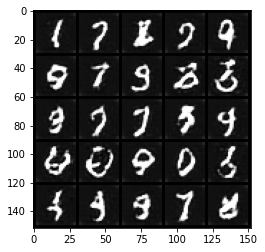

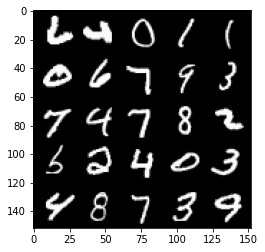

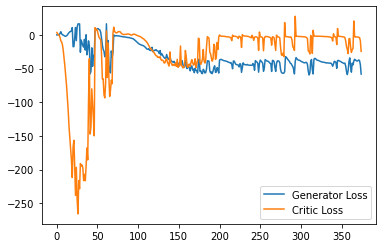

Step 7550: Generator loss: -42.744859809875486, critic loss: 0.2352327647209171


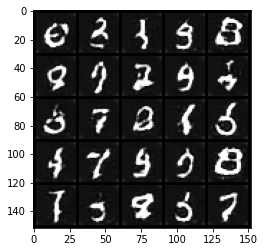

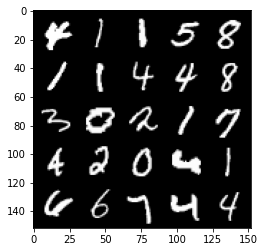

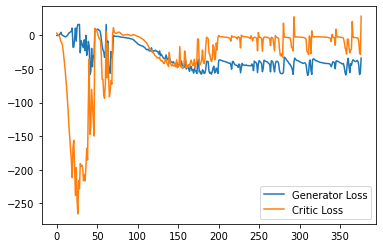

Step 7600: Generator loss: -36.151304931640624, critic loss: -2.6232632226943964


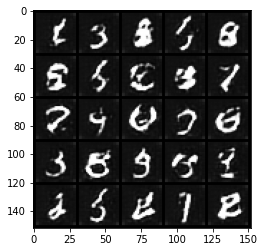

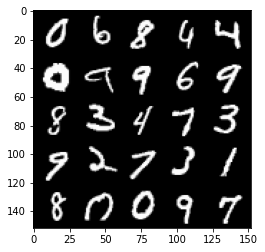

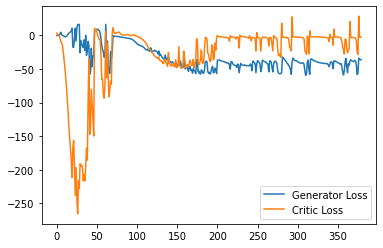

Step 7650: Generator loss: -37.584027404785154, critic loss: -2.8413277883529675


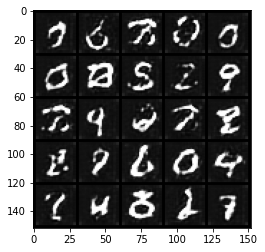

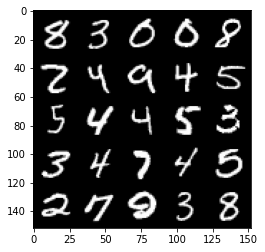

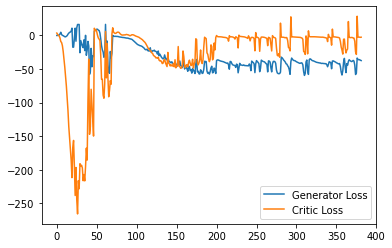

Step 7700: Generator loss: -38.05286247253418, critic loss: -3.3247776241302485


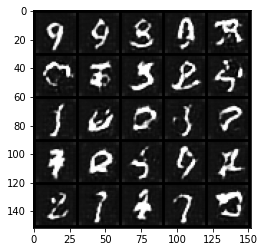

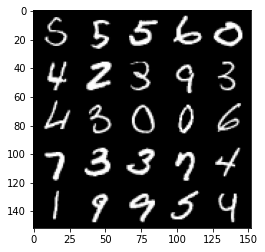

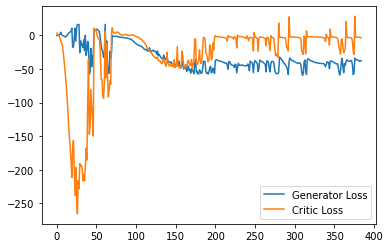

Step 7750: Generator loss: -45.40965278625488, critic loss: -12.557108229637144


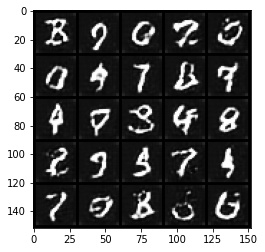

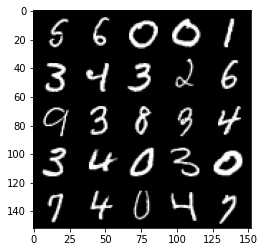

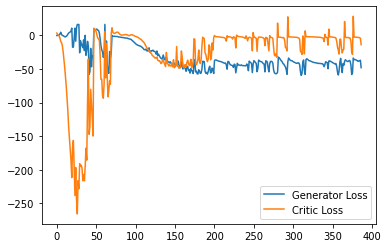

Step 7800: Generator loss: -51.34713413238526, critic loss: -24.508345540046705


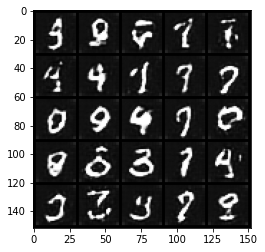

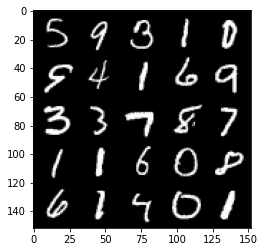

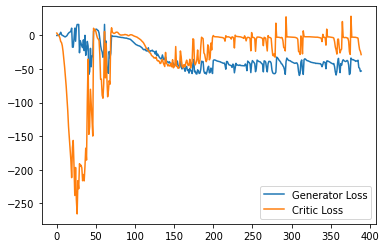

Step 7850: Generator loss: -36.22109573364258, critic loss: 3.5980992984771722


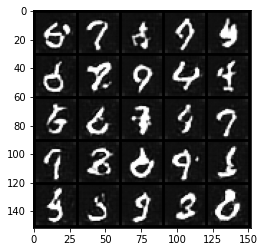

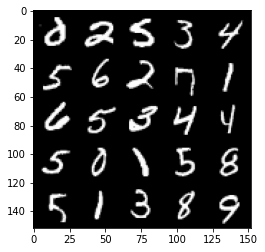

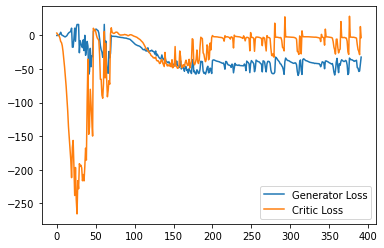

Step 7900: Generator loss: -35.53939422607422, critic loss: -3.7276880681514744


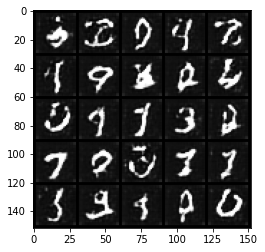

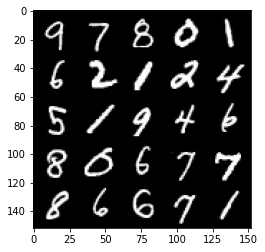

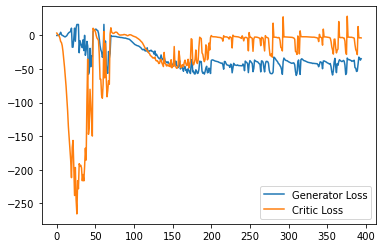

Step 7950: Generator loss: -40.63601547241211, critic loss: -12.81984673309326


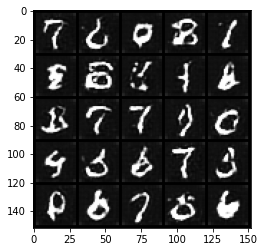

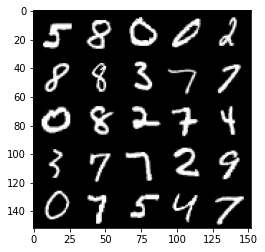

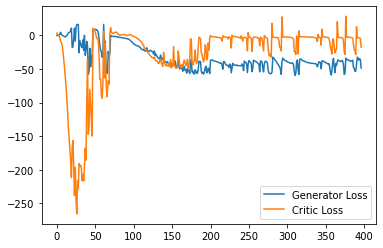

Step 8000: Generator loss: -48.46390960693359, critic loss: -17.089383070945736


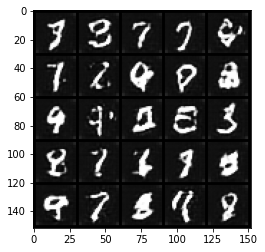

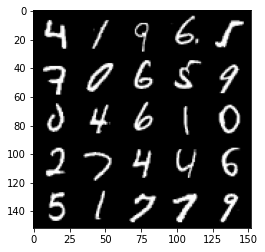

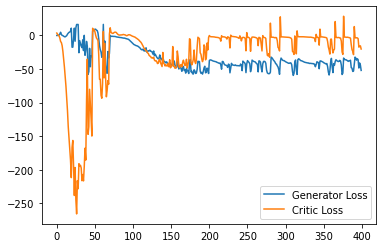

Step 8050: Generator loss: -45.925305137634275, critic loss: -11.699104356765742


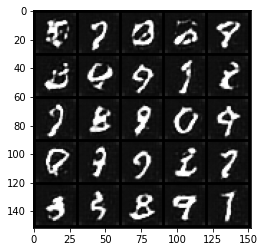

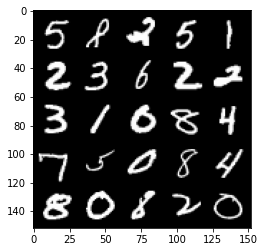

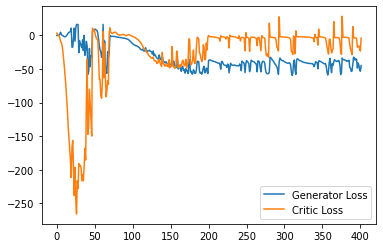

Step 8100: Generator loss: -32.16262405395508, critic loss: -4.277501710891725


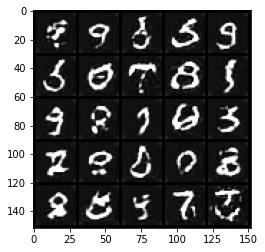

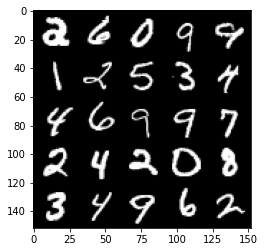

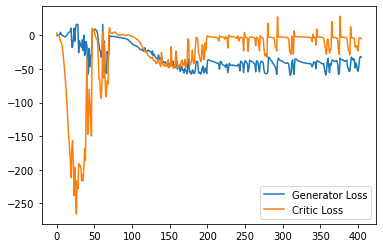

Step 8150: Generator loss: -37.36803657531738, critic loss: -7.526985948562624


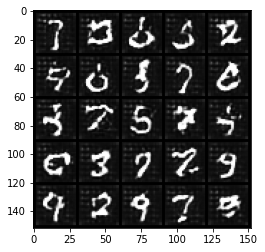

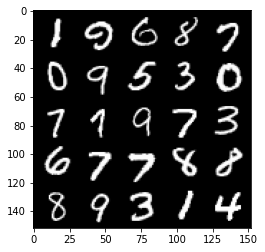

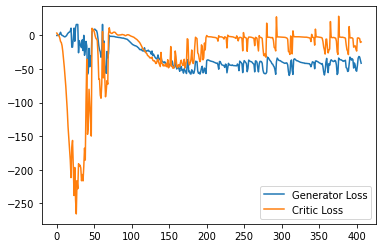

Step 8200: Generator loss: -34.23076248168945, critic loss: -87.2275363006592


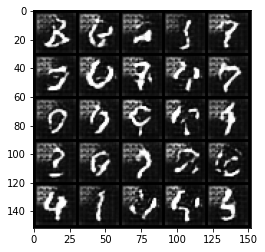

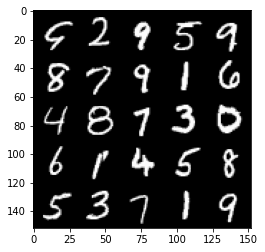

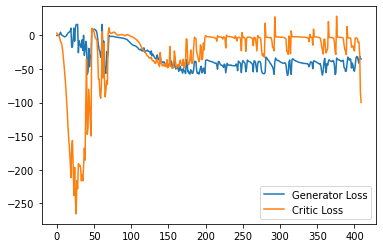

Step 8250: Generator loss: -36.67516990661621, critic loss: -124.29339544677738


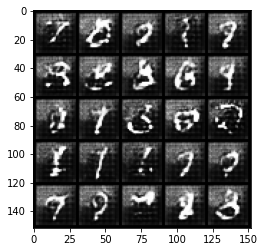

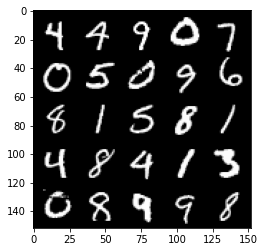

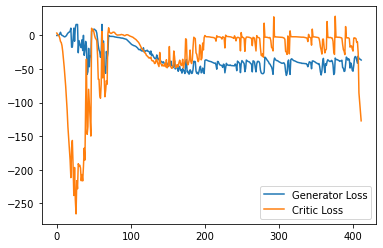

Step 8300: Generator loss: -41.36019515991211, critic loss: -158.95679321289063


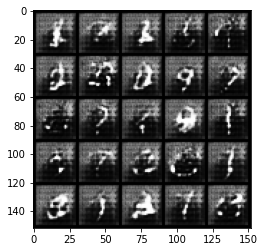

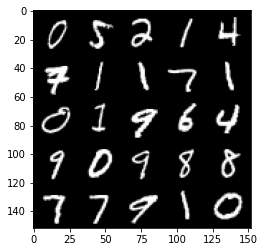

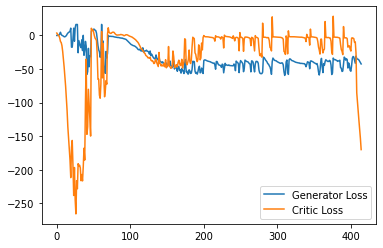

Step 8350: Generator loss: -45.729212799072265, critic loss: -194.84722802734376


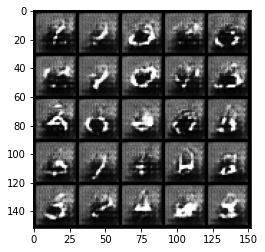

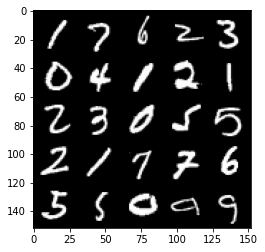

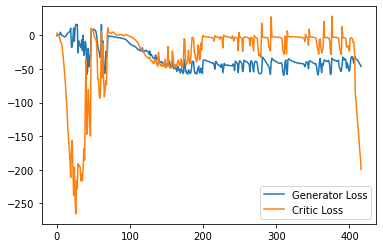

Step 8400: Generator loss: -50.48009735107422, critic loss: -231.88209222412112


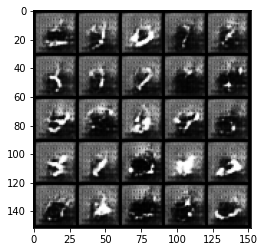

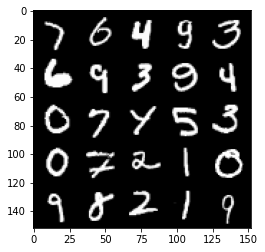

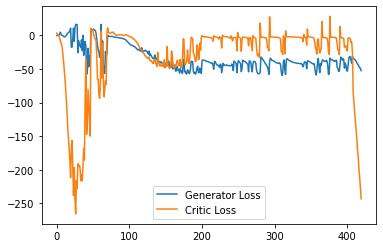

Step 8450: Generator loss: -59.28575096130371, critic loss: -266.72275708007805


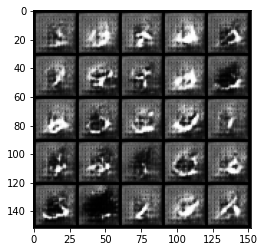

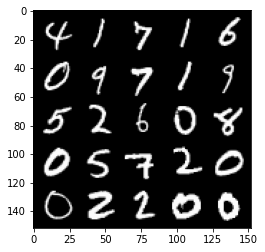

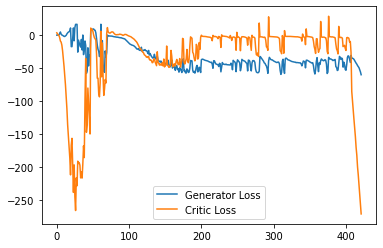

Step 8500: Generator loss: -69.15750610351563, critic loss: -302.51399591064455


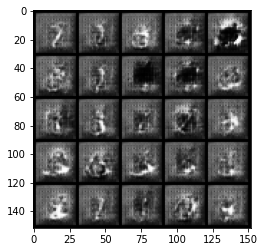

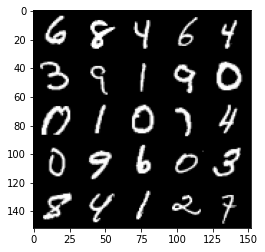

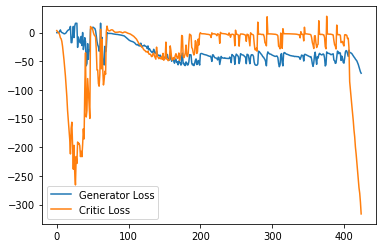

Step 8550: Generator loss: -78.74315299987794, critic loss: -269.60830706024177


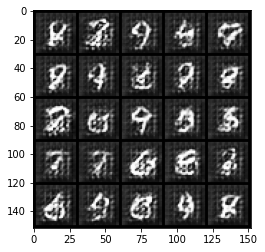

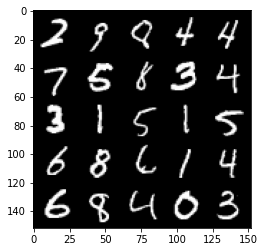

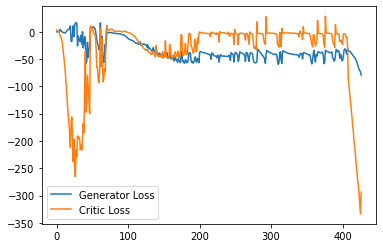

Step 8600: Generator loss: -74.86837799072265, critic loss: 8.090109182357788


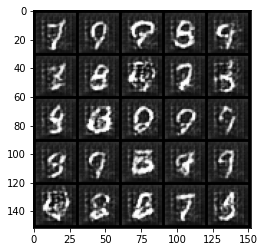

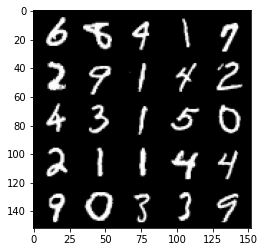

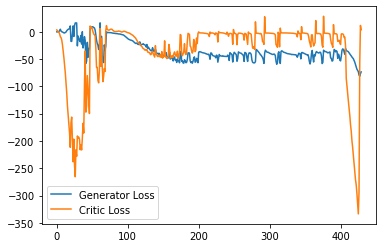

Step 8650: Generator loss: -74.62820098876954, critic loss: 1.089390109062195


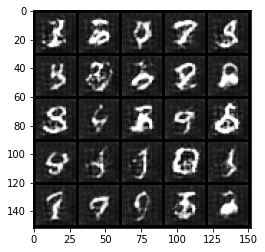

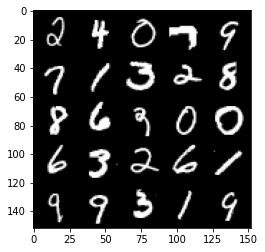

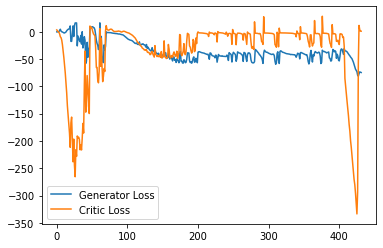

Step 8700: Generator loss: -75.59480346679688, critic loss: 0.8599134531021119


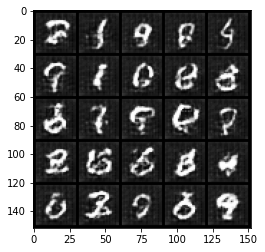

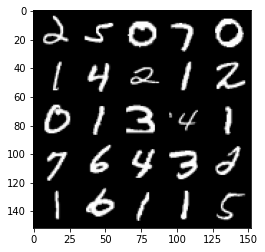

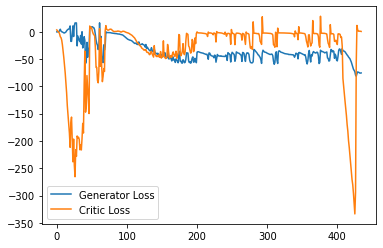

Step 8750: Generator loss: -75.61956237792968, critic loss: 0.15668945837020887


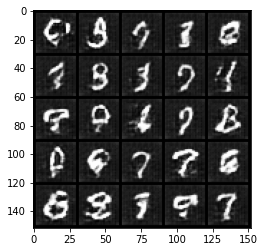

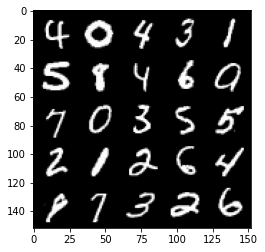

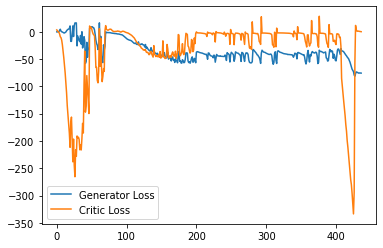

Step 8800: Generator loss: -75.63000350952149, critic loss: -0.20861391115188602


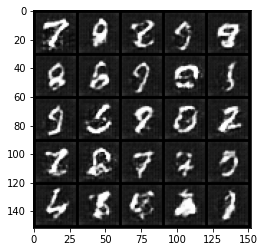

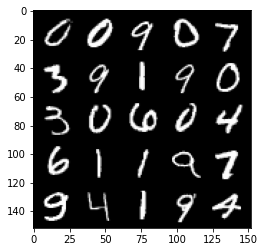

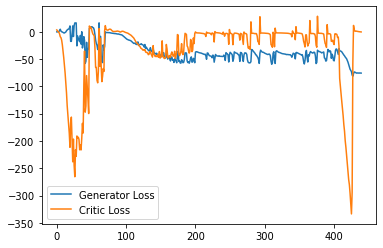

Step 8850: Generator loss: -75.5999658203125, critic loss: -0.5371092526912689


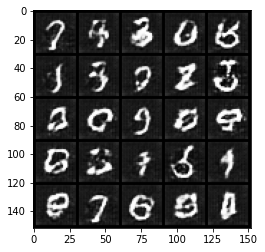

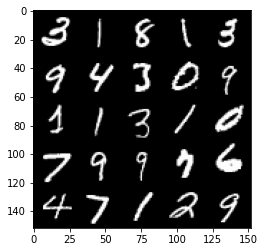

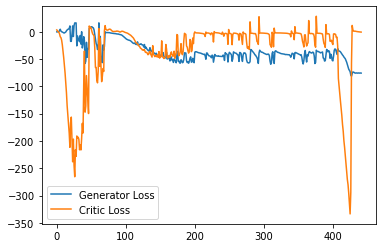

Step 8900: Generator loss: -75.30996215820312, critic loss: -0.7433371691703793


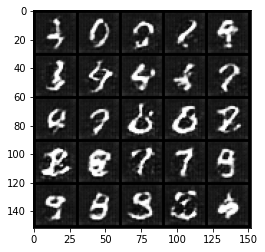

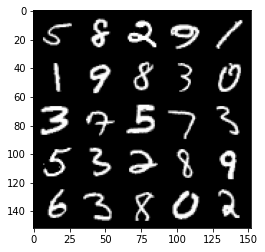

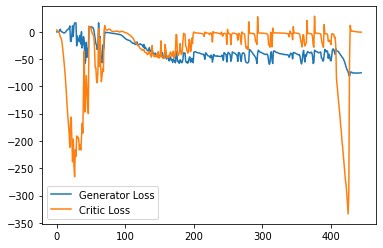

Step 8950: Generator loss: -75.10970138549804, critic loss: -0.7232337477207186


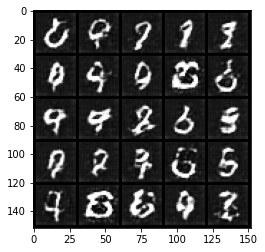

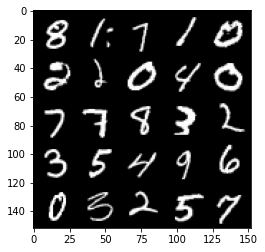

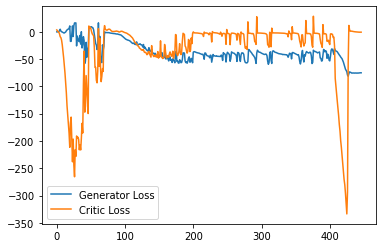

Step 9000: Generator loss: -74.70870422363281, critic loss: -0.8270573914051053


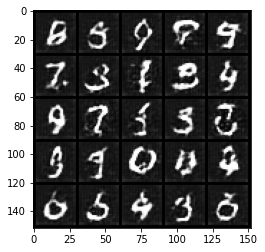

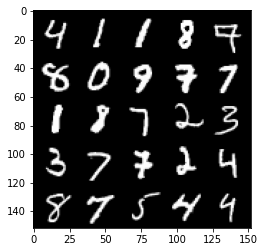

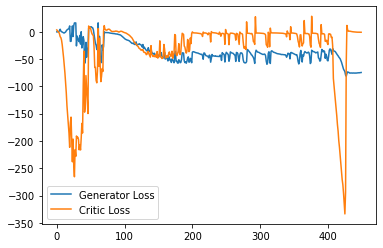

Step 9050: Generator loss: -74.53722091674804, critic loss: -0.9591496448516845


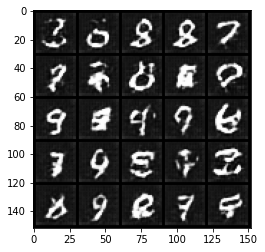

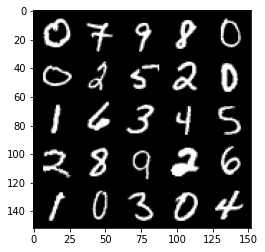

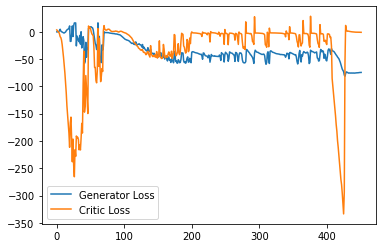

Step 9100: Generator loss: -74.03396911621094, critic loss: -1.1726194145679474


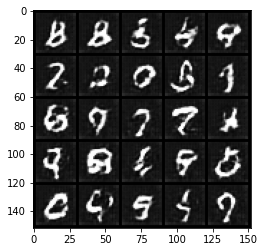

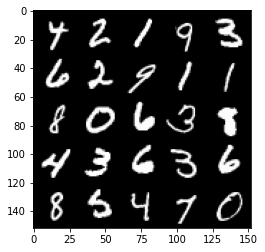

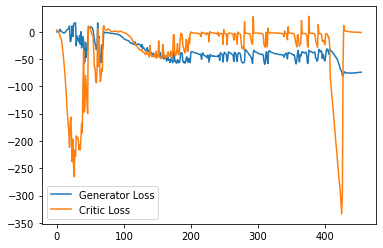

Step 9150: Generator loss: -73.65620269775391, critic loss: -1.3504117374420168


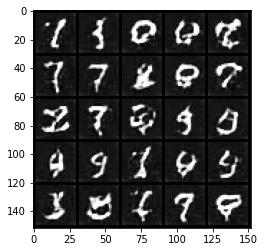

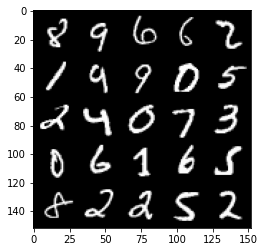

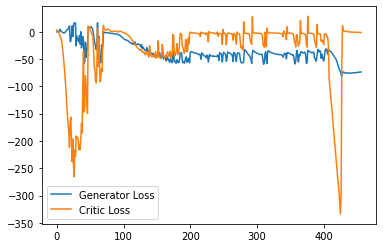

Step 9200: Generator loss: -73.17982162475586, critic loss: -1.5726676375865938


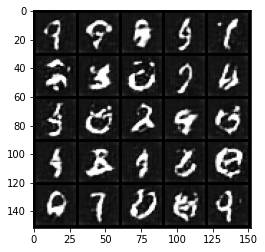

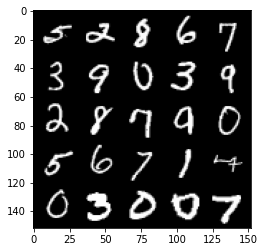

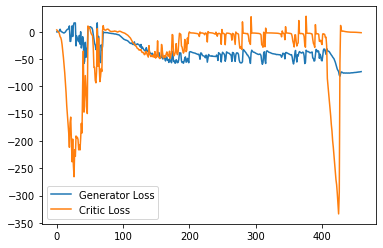

Step 9250: Generator loss: -72.73408477783204, critic loss: -1.7762478802204131


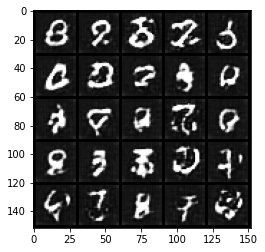

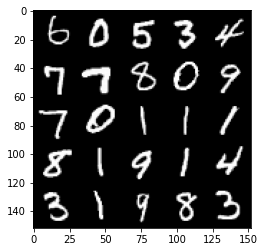

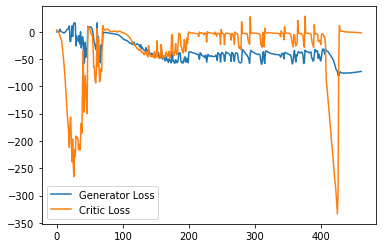

Step 9300: Generator loss: -71.87670867919923, critic loss: -1.9218906786441803


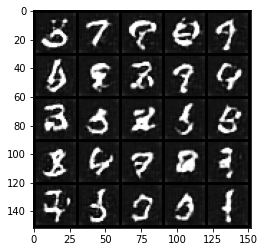

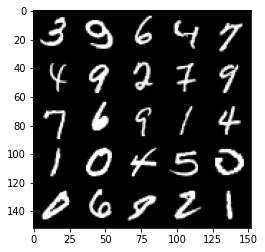

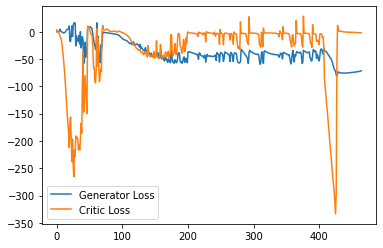

Step 9350: Generator loss: -71.74633209228516, critic loss: -1.858654850482941


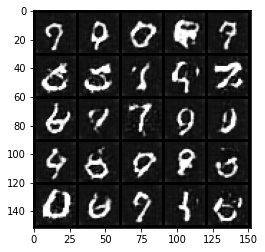

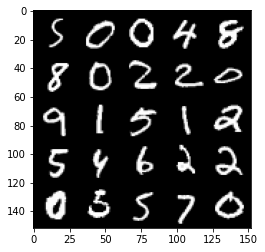

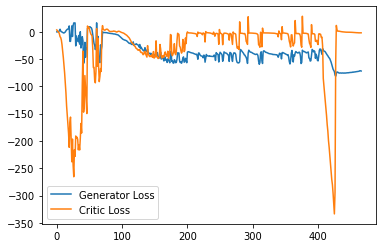

Step 9400: Generator loss: -71.1015364074707, critic loss: -2.378793783664703


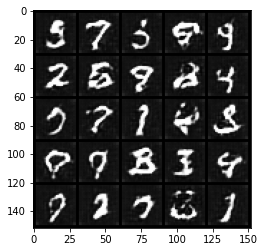

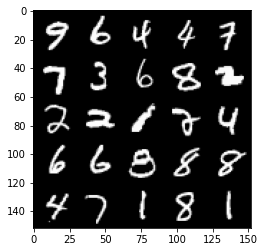

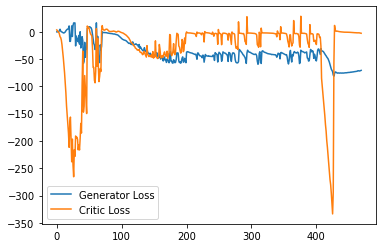

Step 9450: Generator loss: -71.21398025512696, critic loss: -2.5017616424560543


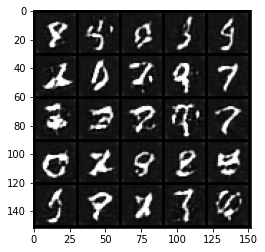

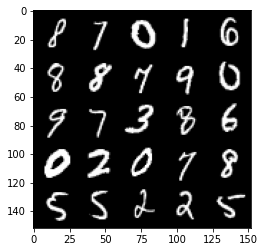

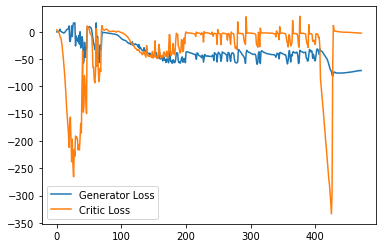

Step 9500: Generator loss: -70.51790176391602, critic loss: -2.6113872520923618


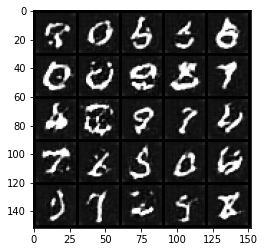

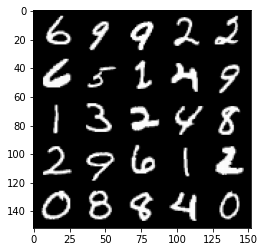

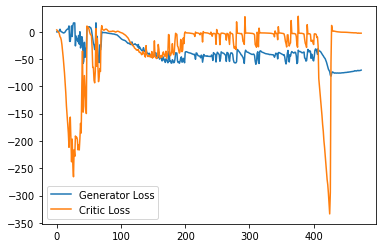

Step 9550: Generator loss: -71.07211441040039, critic loss: -2.8918232078552246


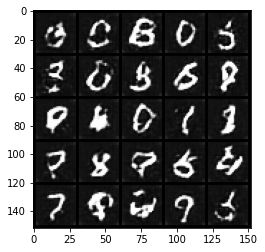

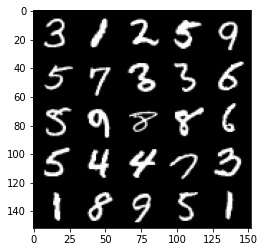

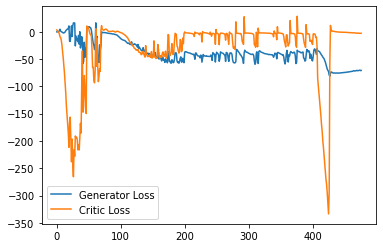

Step 9600: Generator loss: -70.26648040771484, critic loss: -2.8192315890789037


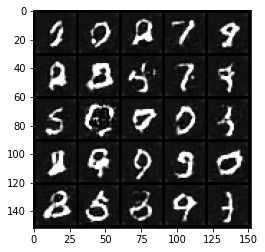

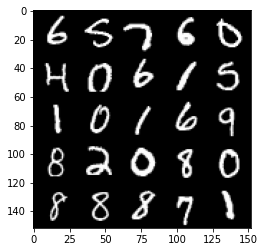

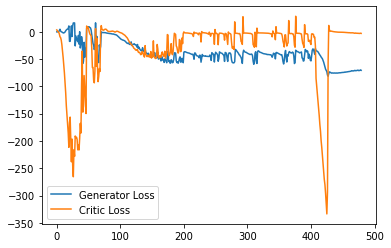

Step 9650: Generator loss: -70.28270034790039, critic loss: -3.3260282156467436


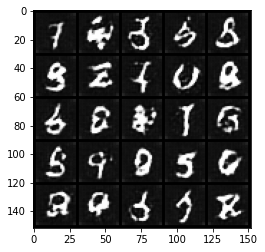

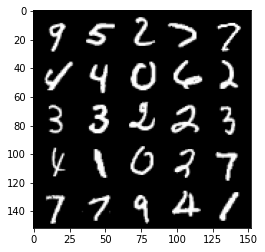

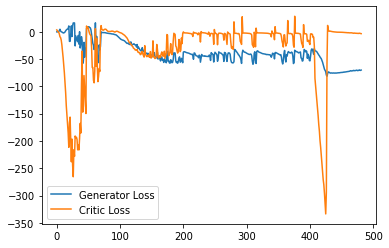

Step 9700: Generator loss: -69.78715484619141, critic loss: 1.7946277105808262


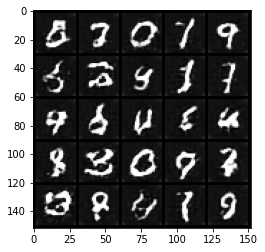

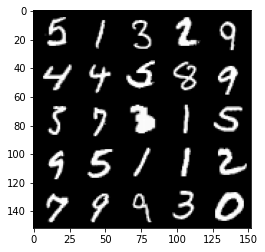

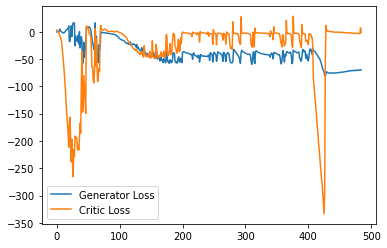

Step 9750: Generator loss: -69.40783645629882, critic loss: -1.1328158259391785


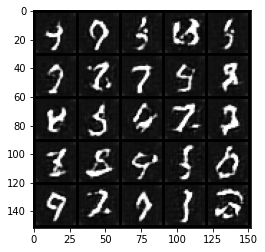

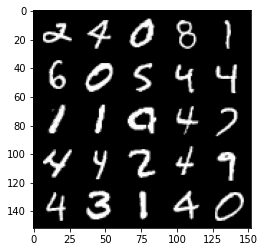

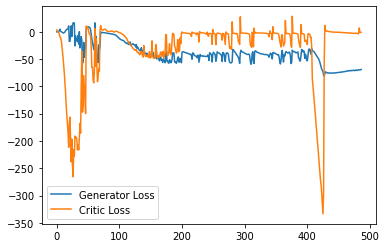

Step 9800: Generator loss: -69.29877593994141, critic loss: -1.4460227847099307


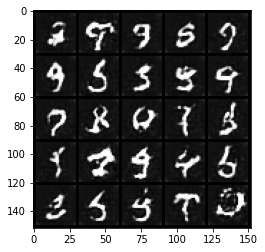

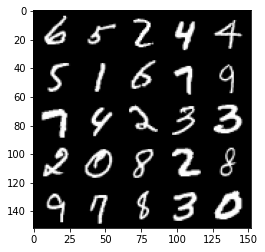

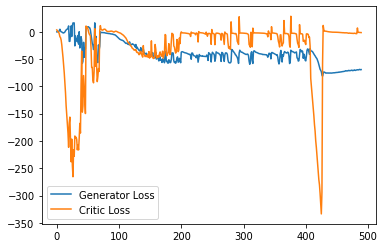

Step 9850: Generator loss: -70.02679077148437, critic loss: -2.000484967708587


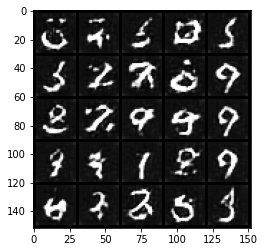

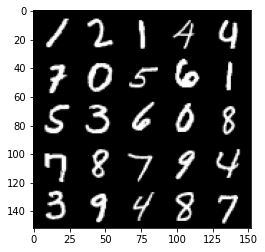

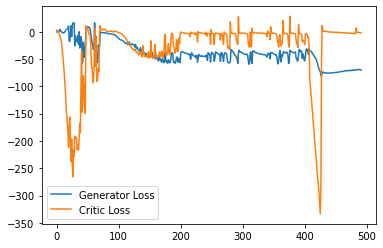

Step 9900: Generator loss: -70.82389465332031, critic loss: -2.721242740392685


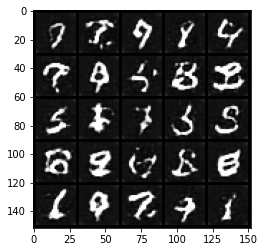

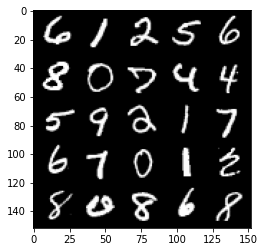

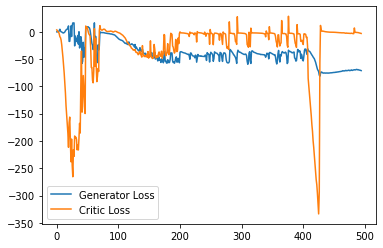

Step 9950: Generator loss: -69.84849273681641, critic loss: -3.164957505464553


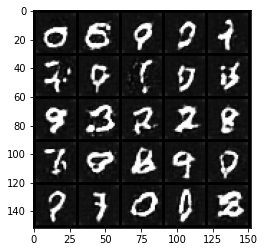

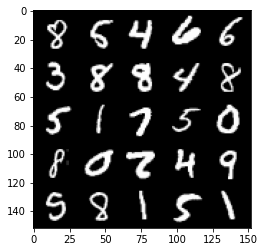

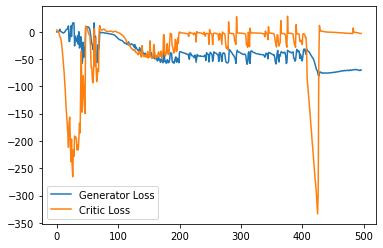

Step 10000: Generator loss: -69.46861694335938, critic loss: -3.500132392406463


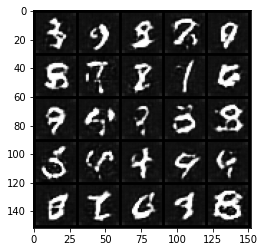

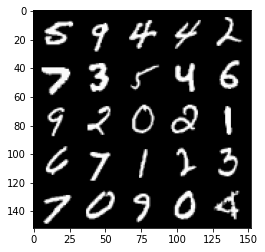

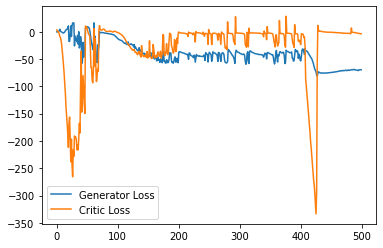

Step 10050: Generator loss: -68.64255950927735, critic loss: -3.7390683102607727


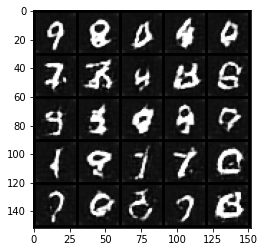

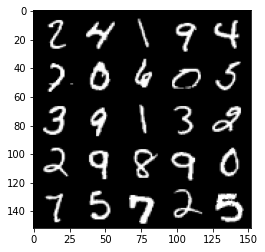

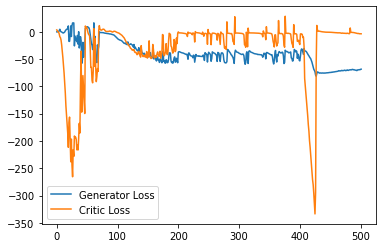

Step 10100: Generator loss: -68.56950927734376, critic loss: -4.039904846668244


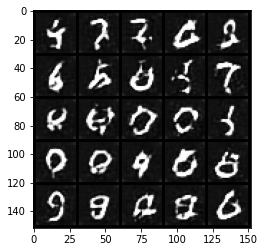

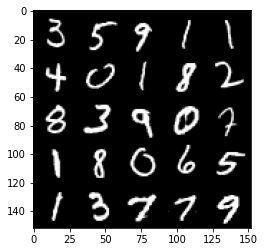

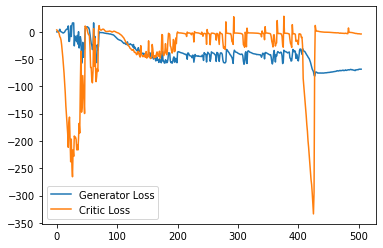

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
